# cml1 - Immobilienrechner
## Explorative Datenanalyse

In diesem Notebook analysieren wir den Immobilienmarkt in der Schweiz (Hauptsächlich Immoscout und Homegate). Unser Ziel ist es, Muster in den Immobilienpreisen zu erkennen und zu verstehen, welche Faktoren den Wert einer Immobilie am stärksten beeinflussen.

In [179]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import geopandas

import warnings

warnings.filterwarnings('ignore', category=UserWarning, module='seaborn')

Hier importieren wir den sauberen Datensatz 'immo_data_clean.csv'.

In [180]:
df = pd.read_csv('../data/immo_data_clean.csv', low_memory=False)
df.head()

,price_cleaned,kanton,Zip,Year built:,type_unified,Availability_Categorized,Living_area_unified,Floor_unified,Floor_space_merged,Plot_area_unified,...,PopulationDensityS,RiversAndLakesL,RiversAndLakesM,RiversAndLakesS,WorkplaceDensityL,WorkplaceDensityM,WorkplaceDensityS,ForestDensityL,ForestDensityM,ForestDensityS
0,1150000.0,AG,50,NaN,penthouse,On request,100.0,4.0,NaN,NaN,...,0.366674,0.082170,0.001811,0.011871,0.030169,0.052120,0.098951,0.511176,0.286451,0.090908
1,1420000.0,AG,50,NaN,terrace-house,On request,156.0,NaN,242.0,222.0,...,0.366674,0.082170,0.001811,0.011871,0.030169,0.052120,0.098951,0.511176,0.286451,0.090908
2,720000.0,AG,50,NaN,penthouse,Immediately,93.0,2.0,NaN,NaN,...,0.635194,0.154274,0.188229,0.000000,0.172646,0.163850,0.165830,0.163362,0.095877,0.001911
3,1430000.0,AG,50,NaN,detached-house,On request,154.0,NaN,257.0,370.0,...,0.366674,0.082170,0.001811,0.011871,0.030169,0.052120,0.098951,0.511176,0.286451,0.090908
4,995000.0,AG,50,NaN,flat,On request,142.0,0.0,NaN,NaN,...,0.204549,0.109586,0.141473,0.091805,0.046950,0.038008,0.055509,0.333865,0.279276,0.145835


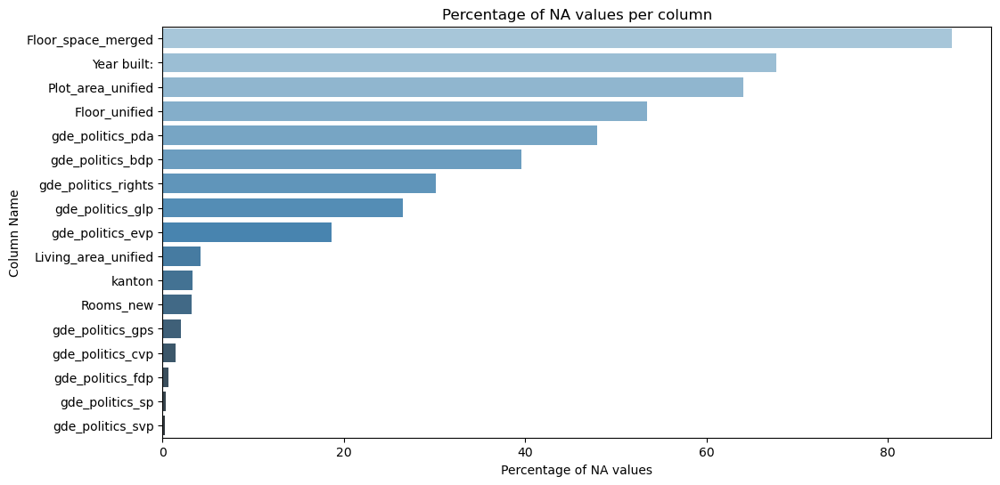

In [181]:
# Initialize an empty dictionary to store the column names and their corresponding NA percentages
na_percent_dict = {}

# Iterate over each column in the DataFrame
for col in df.columns:
    # Calculate the percentage of NA values in the column
    na_percent = round(df[col].isna().sum() / len(df[col]) * 100, 3)
    
    # If the percentage of NA values is greater than 0, add it to the dictionary
    if na_percent > 0.0:
        na_percent_dict[col] = na_percent

# Convert the dictionary to a Pandas Series for easier plotting
na_percent_series = pd.Series(na_percent_dict)

# Sort the series in descending order
na_percent_series = na_percent_series.sort_values(ascending=False)

# Set up the matplotlib figure
plt.figure(figsize=(12, 6))
sns.barplot(y=na_percent_series.index, x=na_percent_series.values, palette='Blues_d')
plt.title('Percentage of NA values per column')
plt.ylabel('Column Name')
plt.xlabel('Percentage of NA values')
plt.show()

Diese Beobachtung, dass 'Floor_space_merged', 'Year_build' und 'Plot_area_unified' mehr als 50% fehlende Werte aufweisen, könnte darauf hindeuten, dass diese Informationen entweder generell nicht verfügbar sind oder häufig in den Daten fehlen. Dies müssen wir für die weitere Analysen gut berücksichtigen.

In [183]:
def distplot(df, col, b, title):
    sns.displot(df[col], kde = True, aspect = 1.5, bins = b)
    plt.title(title)
    plt.xticks(rotation=45)
    plt.ticklabel_format(style='plain', axis='x')
    plt.show()

def scatterplot(df, col1, col2, title):
    plt.figure(figsize=(8, 5))
    sns.scatterplot(data=df, x=col1, y=col2)
    plt.title(title)
    plt.ticklabel_format(style='plain', axis='x')
    plt.show()

### Preis

In diesem Abschnitt legen wir Fokus auf die Analyse der Immobilienpreise. Wir beginnen mit der Analyse der Verteilung der Immobilienpreise.

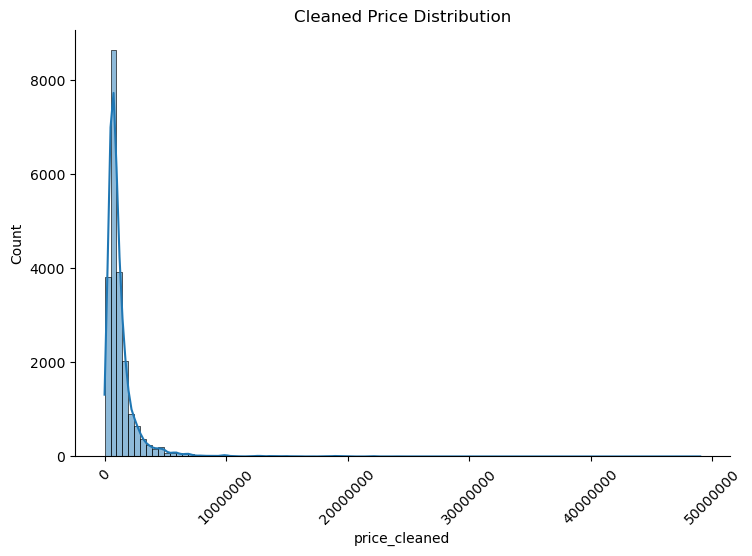

In [184]:
distplot(df, 'price_cleaned', 100, 'Cleaned Price Distribution')

Der Plot zeigt eine rechtsschiefe Verteilung. Es gibt signifikante Ausreisser im bereinigten Preis, weil die x-Achse bis knapp 50 Millionen Franken geht.

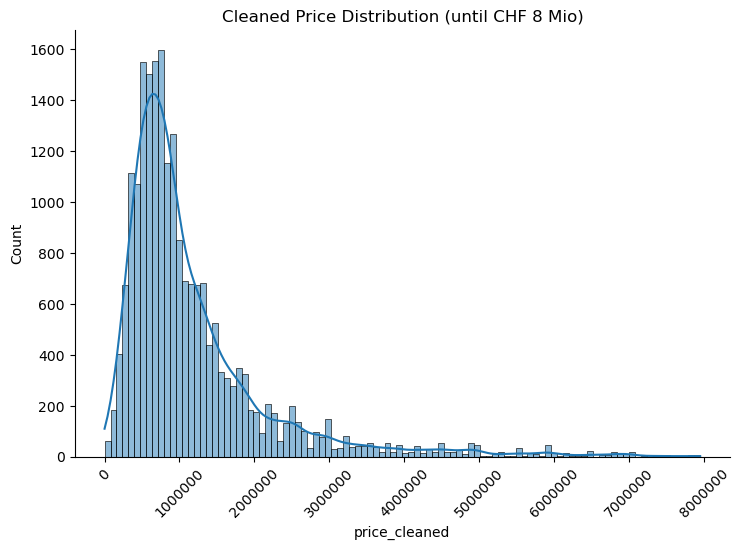

In [185]:
distplot(df[df['price_cleaned'] < 8000000], 'price_cleaned', 100, 'Cleaned Price Distribution (until CHF 8 Mio)')

Bei detaillierterer Betrachtung sehen wir eine schönere Verteilung der Preise. Dazu sehen wir auch wo genau die Preisverteilung liegt, Hauptsächlich zwischen CHF 0 - 2'000'000.

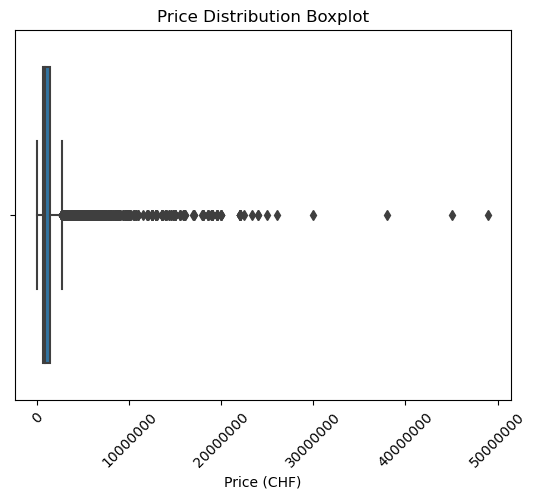

In [186]:
sns.boxplot(x=df['price_cleaned'])
plt.title('Price Distribution Boxplot')
plt.xlabel('Price (CHF)')
plt.xticks(rotation=45)
plt.ticklabel_format(style='plain', axis='x')
plt.show()

Hier sehen wir die Ausreisser deutlicher. Es gibt etwa vier Immobilienobjekte, die einen Wert von über CHF 30'000'000 haben. Wir wissen mit Sicherheit, dass diese Immobilien zu den Ausnahmen gehören, für die es auch eine kleine Anzahl von Interessenten gibt.

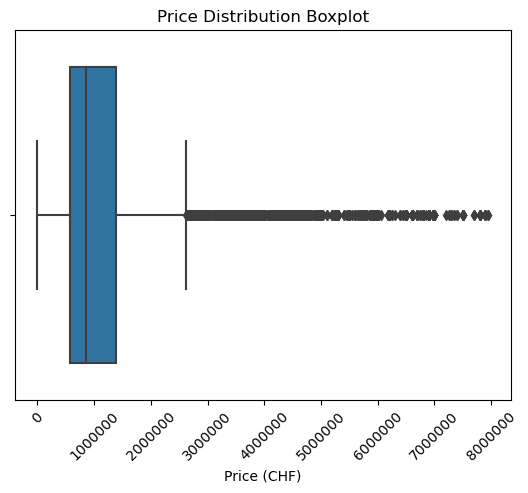

In [187]:
sns.boxplot(x=df[df['price_cleaned'] < 8000000]['price_cleaned'])
plt.title('Price Distribution Boxplot')
plt.xlabel('Price (CHF)')
plt.xticks(rotation=45)
plt.ticklabel_format(style='plain', axis='x')
plt.show()

Wir betrachten hier nun wieder die Immobilienpreise bis CHF 8 Millionen. Der Boxplot zeigt den Median, der näher an Q1 (25%) als an Q3 (75%) liegt, und einer Reihe von Ausreissern am oberen Ende der Preisspanne. Dies deutet darauf hin, dass die meisten Immobilienpreise zwar im unteren bis mittleren Bereich liegen, es aber auch eine beträchtliche Anzahl von Immobilien gibt, die viel teurer sind, was den Durchschnittspreis nach oben verschieben könnte.

Nun untersuchen wir andere Variablen, die den Preis beeinflussen könnten.

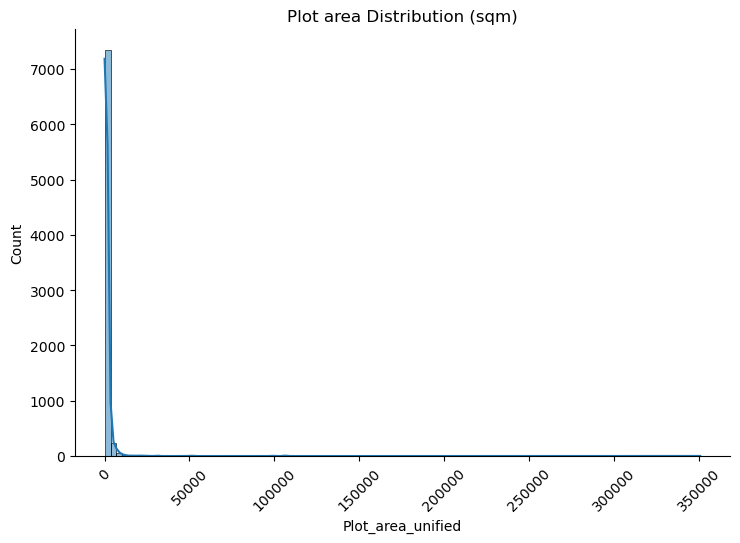

In [188]:
distplot(df, 'Plot_area_unified', 100, 'Plot area Distribution (sqm)')

Wir sehen eine deutlich rechtsschiefe Verteilung mit sehr grosse Ausreissern.

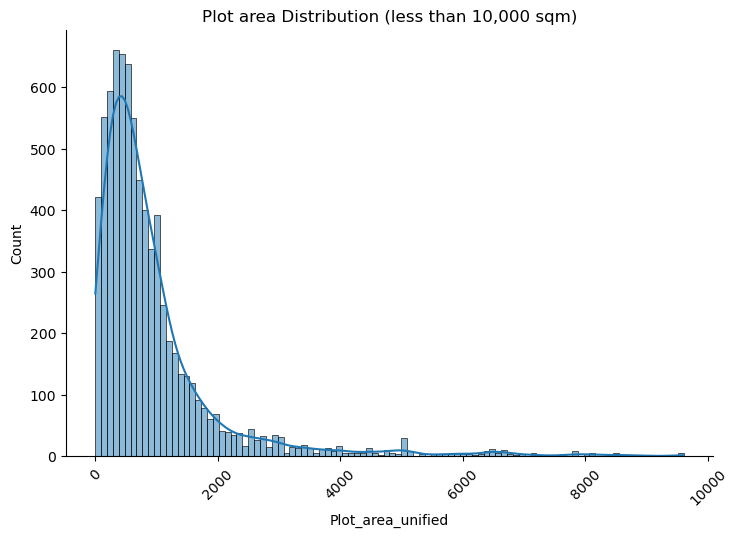

In [189]:
distplot(df[df['Plot_area_unified'] < 10000], 'Plot_area_unified', 100, 'Plot area Distribution (less than 10,000 sqm)')

Wenn wir die Verteilung genauer betrachten, sehen wir eine ähnliche Verteilung wie bei den Immobilienpreisen. Die meisten Immobilien sind bis zu 1500 m2 gross, aber es gibt auch einige sehr grosse Immobilien.

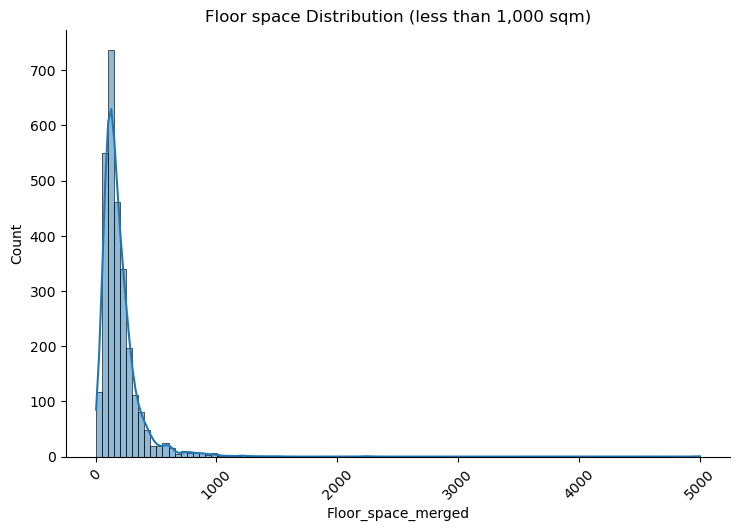

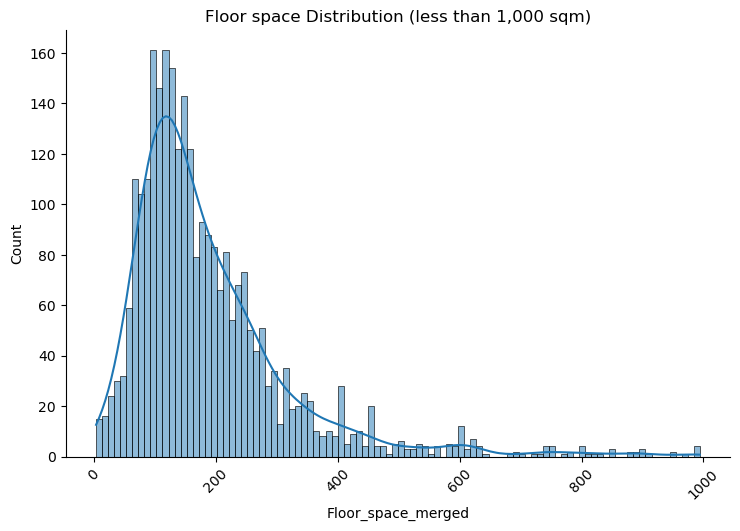

In [190]:
distplot(df, 'Floor_space_merged', 100, 'Floor space Distribution (less than 1,000 sqm)')
distplot(df[df['Floor_space_merged'] < 1000], 'Floor_space_merged', 100, 'Floor space Distribution (less than 1,000 sqm)')

Die Verteilung von Floor Space ist wieder rechtsschief und hat grosse Ausreisser. Die meisten Immobilien haben einen "Floor space" zwischen 100 und 200 m2.

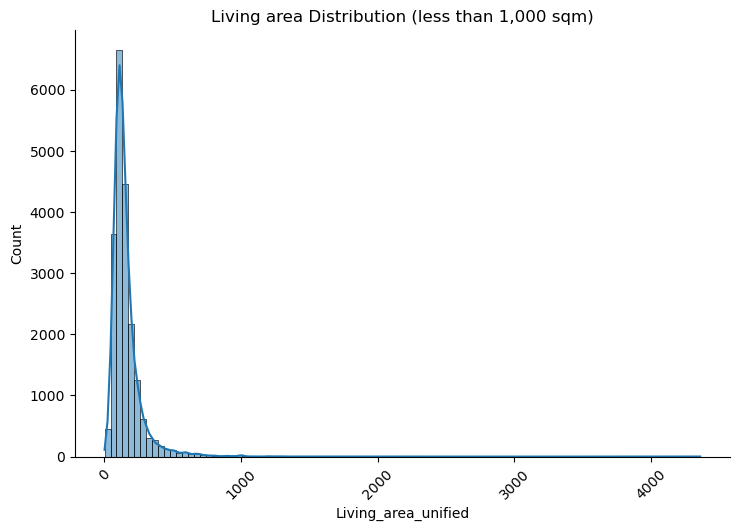

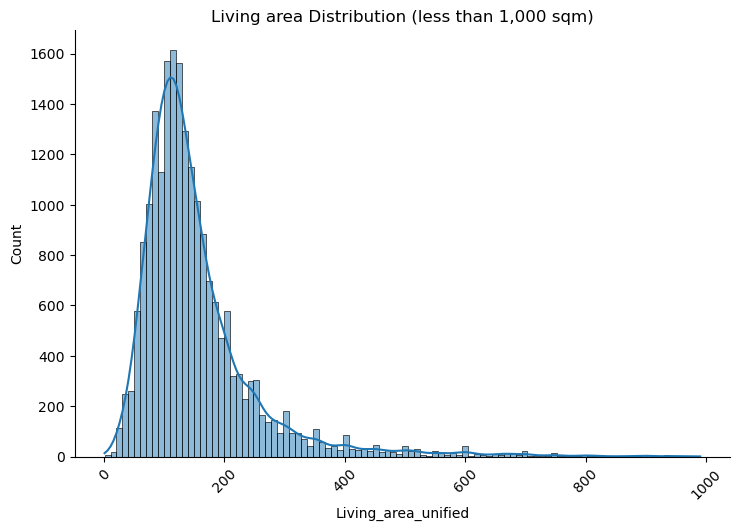

In [191]:
distplot(df, 'Living_area_unified', 100, 'Living area Distribution (less than 1,000 sqm)')
distplot(df[df['Living_area_unified'] < 1000], 'Living_area_unified', 100, 'Living area Distribution (less than 1,000 sqm)')

Die Verteilung des Grundflächenraums ist ebenfalls rechtsschief, wobei bei näherer Untersuchung keine bemerkenswerten Abweichungen feststellbar sind. Die Mehrheit der Objekte liegt unter 1000 m², mit einem Schwerpunkt bei etwa 120 m².

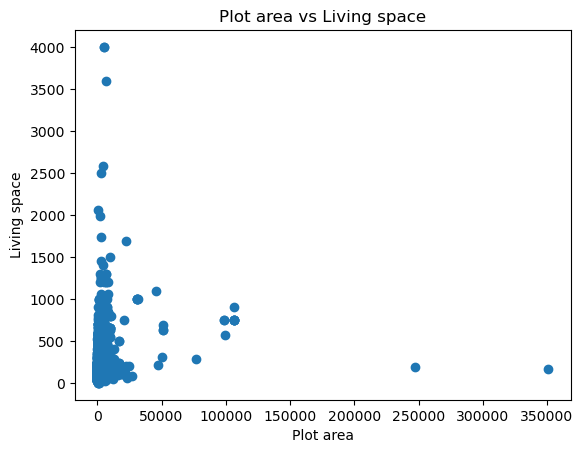

In [192]:
plt.scatter(df['Plot_area_unified'], df['Living_area_unified'])
plt.title('Plot area vs Living space')
plt.xlabel('Plot area')
plt.ylabel('Living space')
plt.show()

Das Streudiagramm zwischen "Living Space" und "Plot Area" zeigt, dass sich die meisten Datenpunkte am unteren Ende beider Variablen befinden, was darauf hindeutet, dass kleinere Wohnflächen eher auf kleineren Grundstücken zu finden sind. Es gibt auch einige Ausreisser, die darauf hindeuten, dass grössere Wohnflächen nicht proportional mit der Grundstücksgrösse zunehmen, und einige wenige Fälle von sehr grossen Grundstücksflächen mit bescheidenen Wohnflächen, was wahrscheinlich Bauernhöfe sind.

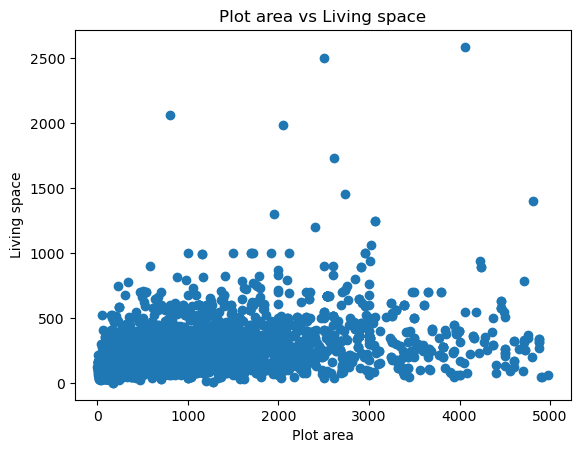

In [193]:
plt.scatter(df[df['Plot_area_unified'] < 5000]['Plot_area_unified'], df[df['Plot_area_unified'] < 5000]['Living_area_unified'])
plt.title('Plot area vs Living space')
plt.xlabel('Plot area')
plt.ylabel('Living space')
plt.show()

Das detaillierte Streudiagramm deutet auf eine schwache bis mässig positive Korrelation zwischen "Grundstücksfläche" und "Wohnfläche" hin, da die meisten Datenpunkte darauf hindeuten, dass grössere Grundstücksflächen häufig auch grösseren Wohnflächen entsprechen. Die Beziehung scheint jedoch weder stark noch linear zu sein, denn es gibt eine breite Streuung der Wohnflächengrössen über eine Reihe von Grundstücksgrössen hinweg.

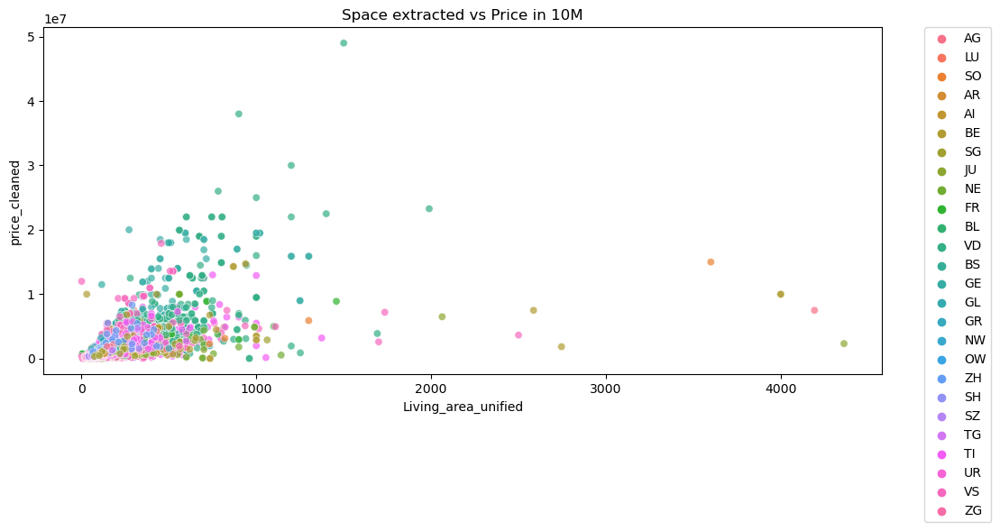

In [194]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df, x='Living_area_unified', y='price_cleaned', hue='kanton', alpha=0.7)
plt.title('Space extracted vs Price (CHF 10 Mio)')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

Das Streudiagramm zeigt das Verhältnis zwischen Wohnfläche und Preis, farblich kodiert nach Kantonen, was auf eine einigermassen positive Beziehung hindeutet, bei der grössere Wohnflächen im Allgemeinen mit höheren Preisen einhergehen. Darüber hinaus gibt es grosse Preisunterschiede innerhalb ähnlicher Wohnflächen, die möglicherweise durch den Standort (Kanton) beeinflusst werden, wie die farbliche Unterscheidung zeigt.

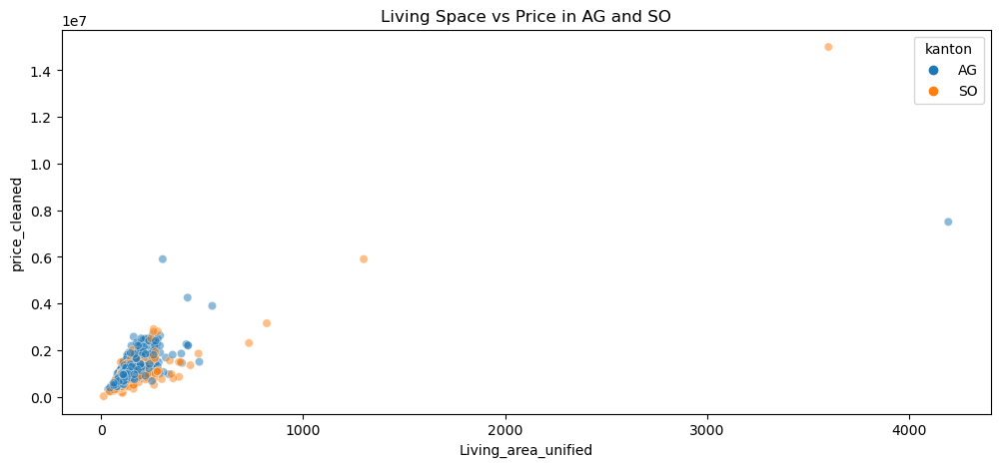

In [195]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df[df['kanton'].isin(['AG', 'SO'])], x='Living_area_unified', y='price_cleaned', hue='kanton', alpha=0.5)
plt.title('Living Space vs Price in AG and SO')
plt.show()

Hier sehen wir den Vergleich zwischen Kanton Aargau und Solothurn. Es gibt keine signifikanten Unterschiede zwischen den beiden Kantonen.

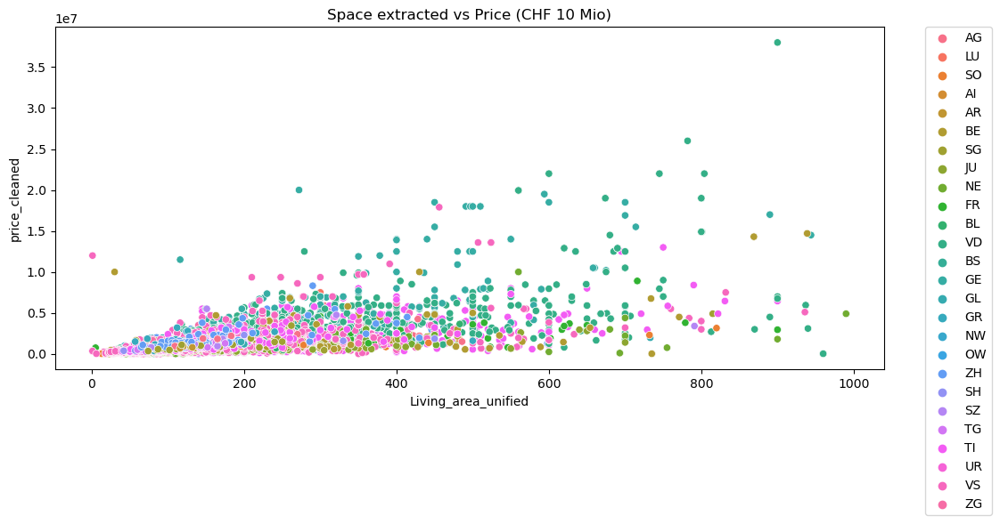

In [224]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df[df['Living_area_unified'] < 1000], x='Living_area_unified', y='price_cleaned', hue='kanton')
plt.title('Space extracted vs Price (CHF 10 Mio)')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

Hier nochmal das gleiche aber nur mit extrahierter Fläche bis 1000m²

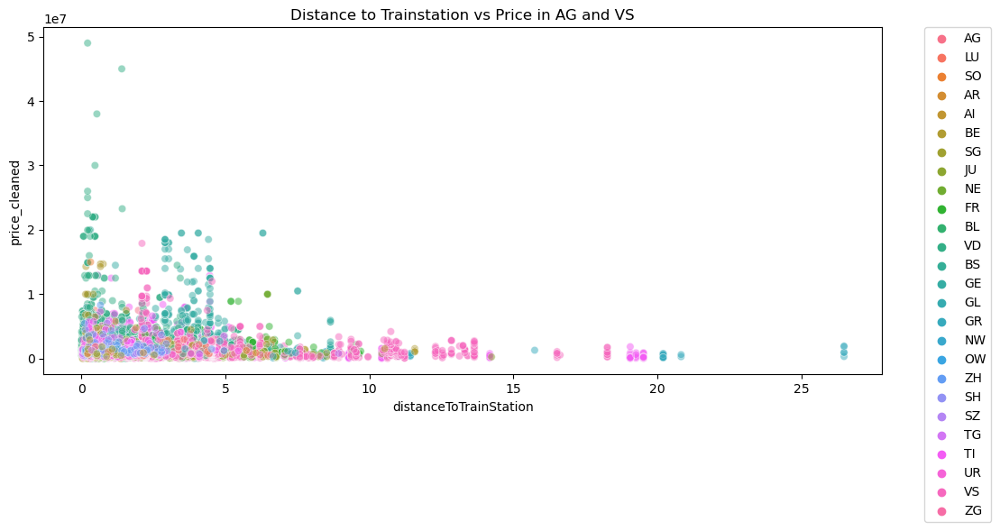

In [197]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df, x='distanceToTrainStation', y='price_cleaned', hue='kanton', alpha=0.5)
plt.title('Distance to Trainstation vs Price in AG and VS')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

Bei 'Price Cleaned' treten logischerweise immer dieselben Ausreisser auf. Interessanterweise lässt sich hier auch erkennen, dass Kantone in den Alpenregionen tendenziell mehr Ausreisser in Bezug auf die Anbindung an öffentliche Verkehrsmittel aufweisen. Dies könnte auf das Vorhandensein von Ferienresidenzen hindeuten.

Vergleichen wir nun die Distanz zu einem Bahnhof mit ein Kanton in den Bergen (Wallis) und ein Kanton hauptsächlich im Mittelland (Waadt).

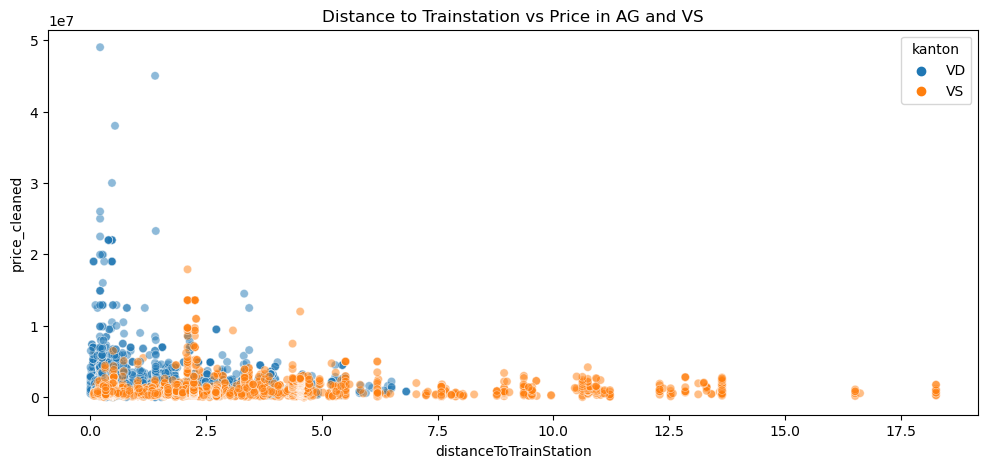

In [198]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df[df['kanton'].isin(['VD', 'VS'])], x='distanceToTrainStation', y='price_cleaned', hue='kanton', alpha=0.5)
plt.title('Distance to Trainstation vs Price in AG and VS')
plt.show()

Wir sehen hier deutlich, dass die Immobilien im Wallis tendenziell weiter von einem Bahnhof entfernt sind als die Immobilien in Waadt.

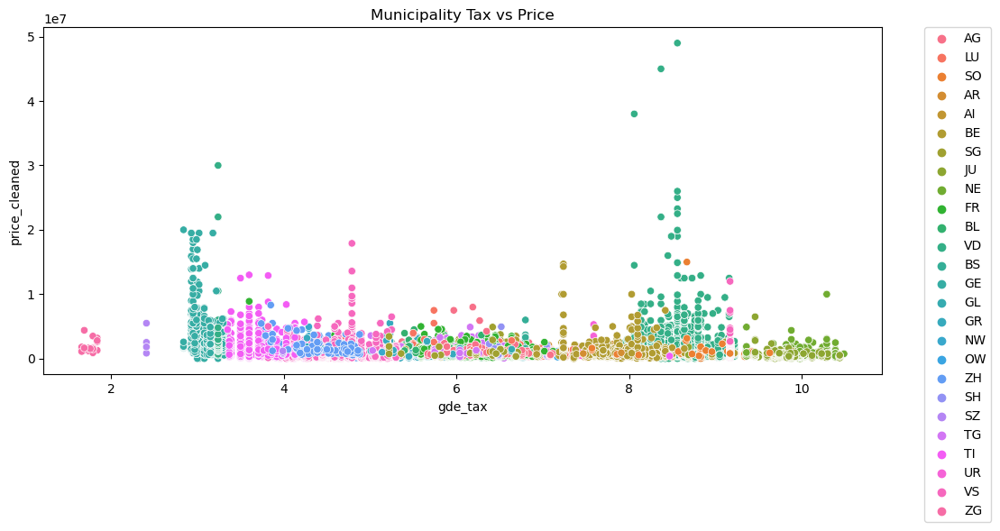

In [199]:
plt.figure(figsize=(12, 5))
sns.scatterplot(data=df, x='gde_tax', y='price_cleaned', hue='kanton')
plt.title('Municipality Tax vs Price')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

Es ist interessant zu sehen, dass man viele Gruppierungen erkennen kann. Man erkennt sofort, wo man am wenigsten und am meisten zahlt. Es ist offensichtlich und logisch, dass der Kanton einen Einfluss hat, wie am Beispiel des Kantons Zug deutlich wird (im Plot ganz links unten). Dies könnte ein Hinweis auf ein Merkmal sein, dem wir besondere Aufmerksamkeit schenken sollten, da es eine hohe Wahrscheinlichkeit für eine starke Korrelation gibt.

### Immobilienobjekte

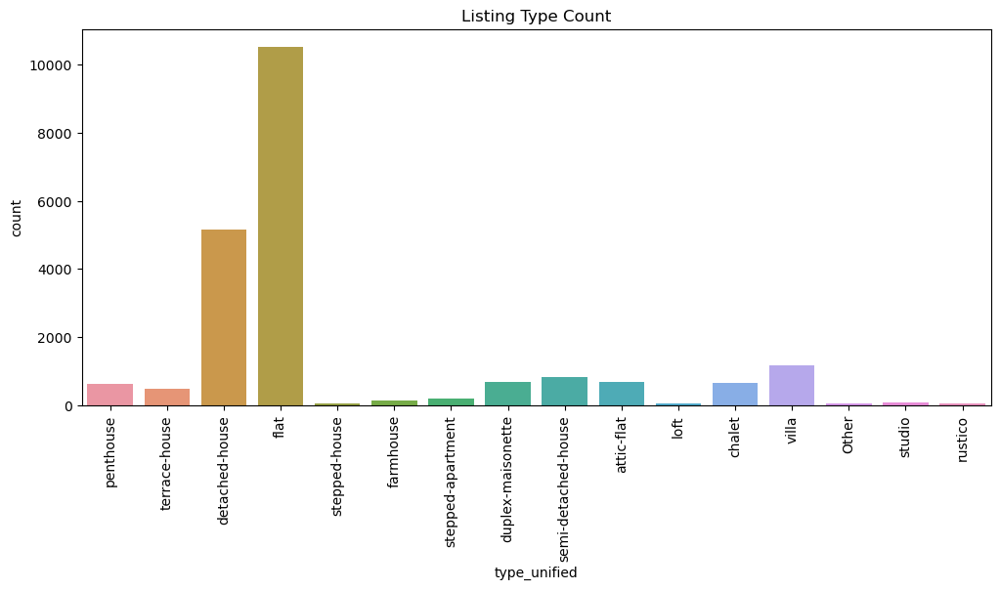

In [200]:
plt.figure(figsize=(12, 5))
sns.countplot(x='type_unified', data=df)
plt.title('Listing Type Count')
plt.xticks(rotation=90)
plt.show()

Hier sehen wir, was die Immobilien genau sind. Wir sehen, dass die meisten Immobilien Wohnungen sind, gefolgt von Häusern. Es gibt einige, die sehr wenig vertreten sind wie stepped-house, loft und rustico.

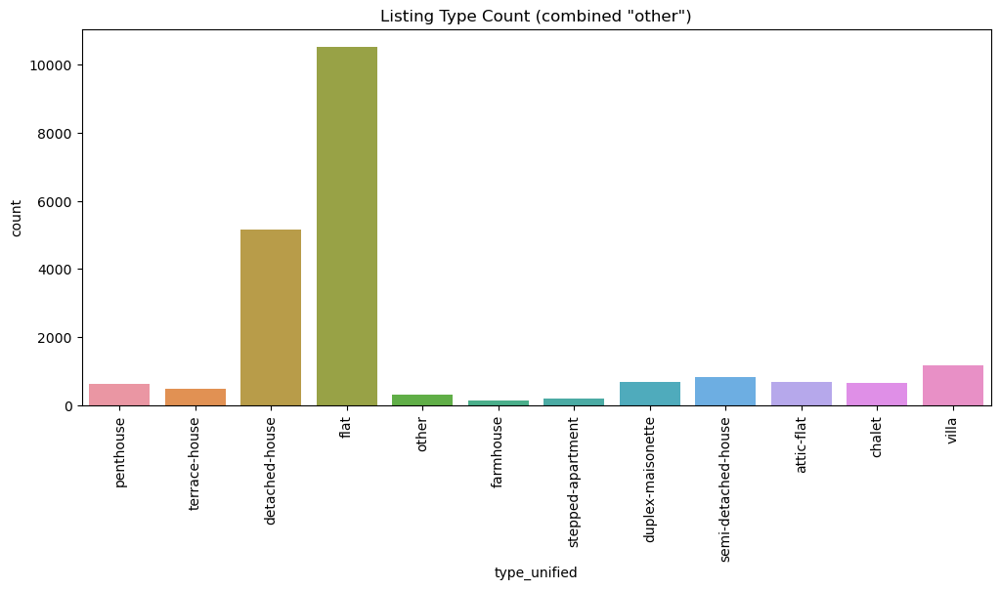

In [201]:
# make a list of types where the count is less than 100
types = df['type_unified'].value_counts()
types = types[types < 100]
types = types.index.tolist()

# replace those types with 'other'
df['type_unified'] = df['type_unified'].replace(types, 'other')

plt.figure(figsize=(12, 5))
plt.xticks(rotation=90)
plt.title('Listing Type Count (combined "other")')
sns.countplot(x='type_unified', data=df)
plt.show()

Beim Vergleich der beiden Plots erscheint es sinnvoll, die kleineren Typen unter der Kategorie 'Other' zusammenzufassen. Es bleibt allerdings zu diskutieren, ab welchem Umfang dieser Schritt sinnvoll ist.

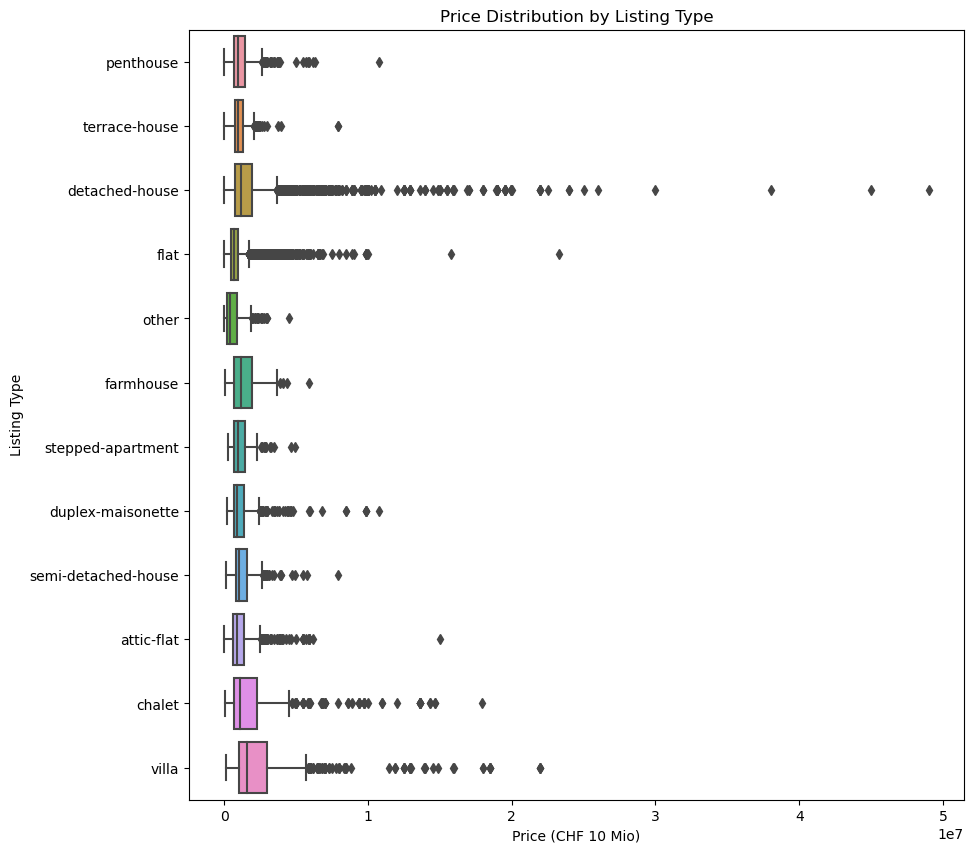

In [202]:
plt.figure(figsize=(10, 10))
sns.boxplot(data=df, x='price_cleaned', y='type_unified')
plt.title('Price Distribution by Listing Type')
plt.ylabel('Listing Type')
plt.xlabel('Price (CHF 10 Mio)')
plt.show()

Das Einfamilienhaus (detached-house) weist mit den zweit-meisten Einträgen die grössten Ausreisser auf. Auffällig ist jedoch, dass diese Kategorie mehr extreme Ausreisser aufweist als Villen, was darauf hindeuten könnte, dass die Typen möglicherweise nicht immer korrekt definiert sind.

'Other' Objekte sind erwartungsgemäss günstig.

Da die Kategorie 'Other' wenige Ausreisser aufweist und ihre Preisspanne eher kompakt ist, bestätigt dies, dass eine solche Klassifizierung durchaus sinnvoll sein könnte, zumindest was den Preis betrifft.

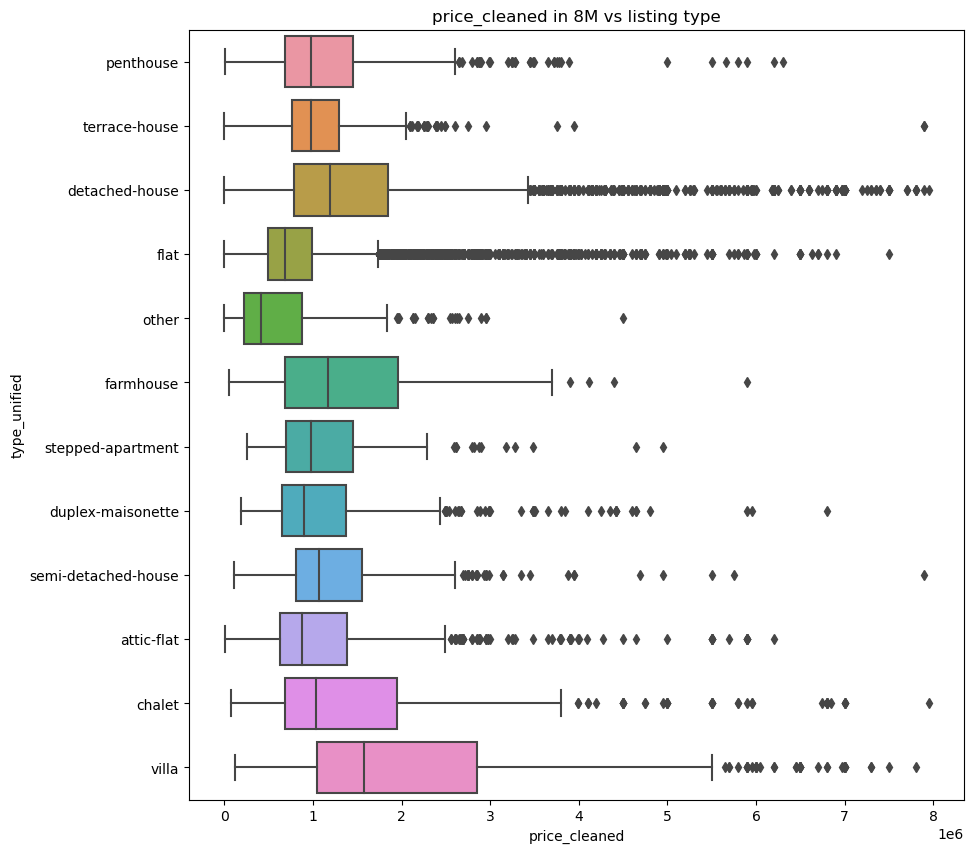

In [203]:
# same as above but only with prices until 8 Mio
plt.figure(figsize=(10, 10))
sns.boxplot(data=df[df['price_cleaned'] < 8000000], x='price_cleaned', y='type_unified')
plt.title('price_cleaned in 8M vs listing type')
plt.show()

Das gleiche wie oben, aber Preis bis CHF 8 Mio.

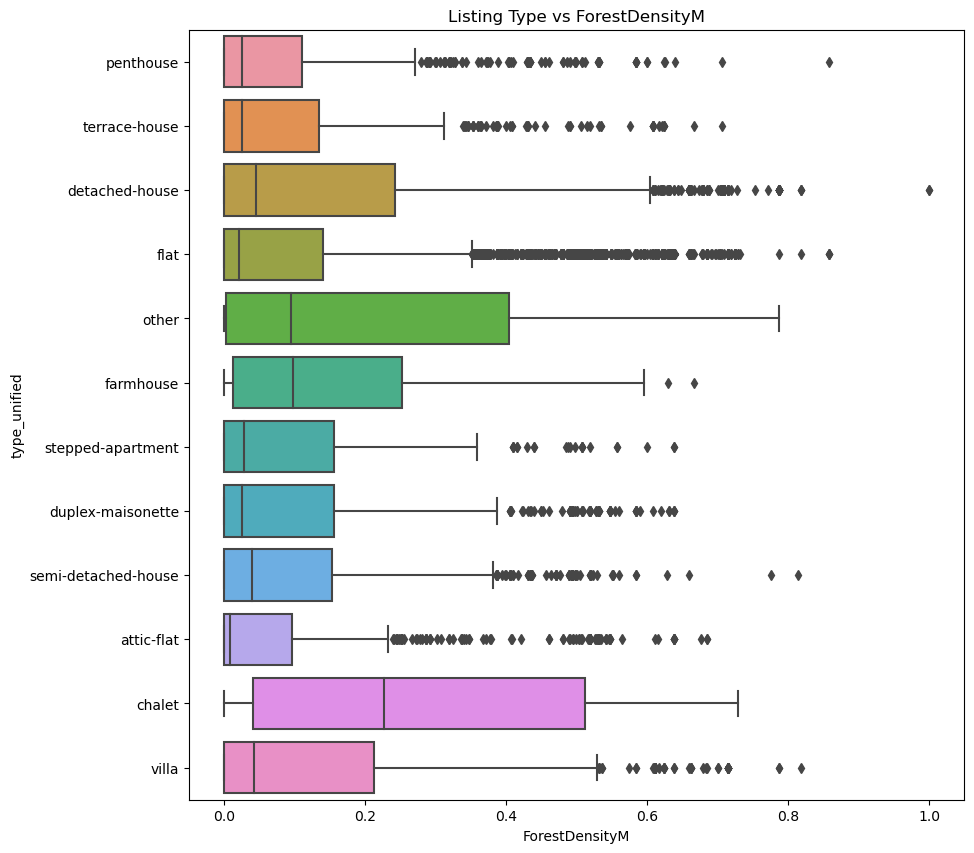

In [204]:
plt.figure(figsize=(10, 10))
sns.boxplot(data=df, x='ForestDensityM', y='type_unified')
plt.title('Listing Type vs ForestDensityM')
plt.show()

Die Waldflächendichte ('Forest Density') scheint nicht stark vom Immobilientyp abzuhängen. Lediglich bei Rusticos ist ein höherer Durchschnittswert feststellbar.

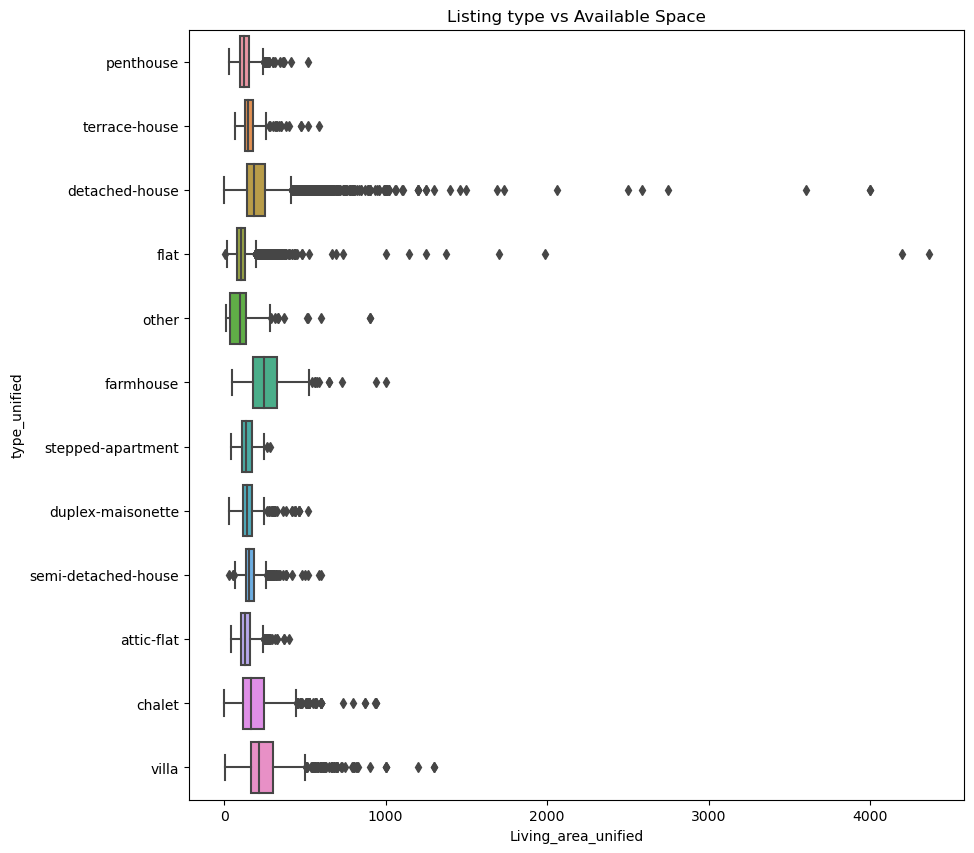

In [205]:
plt.figure(figsize=(10, 10))
sns.boxplot(data=df, x='Living_area_unified', y='type_unified')
plt.title('Listing type vs Available Space')
plt.show()

Die Verteilungen ähneln denen beim Preis, was sinnvoll erscheint, angesichts der vermuteten deutlichen Korrelation zwischen Platzangebot und Preis.

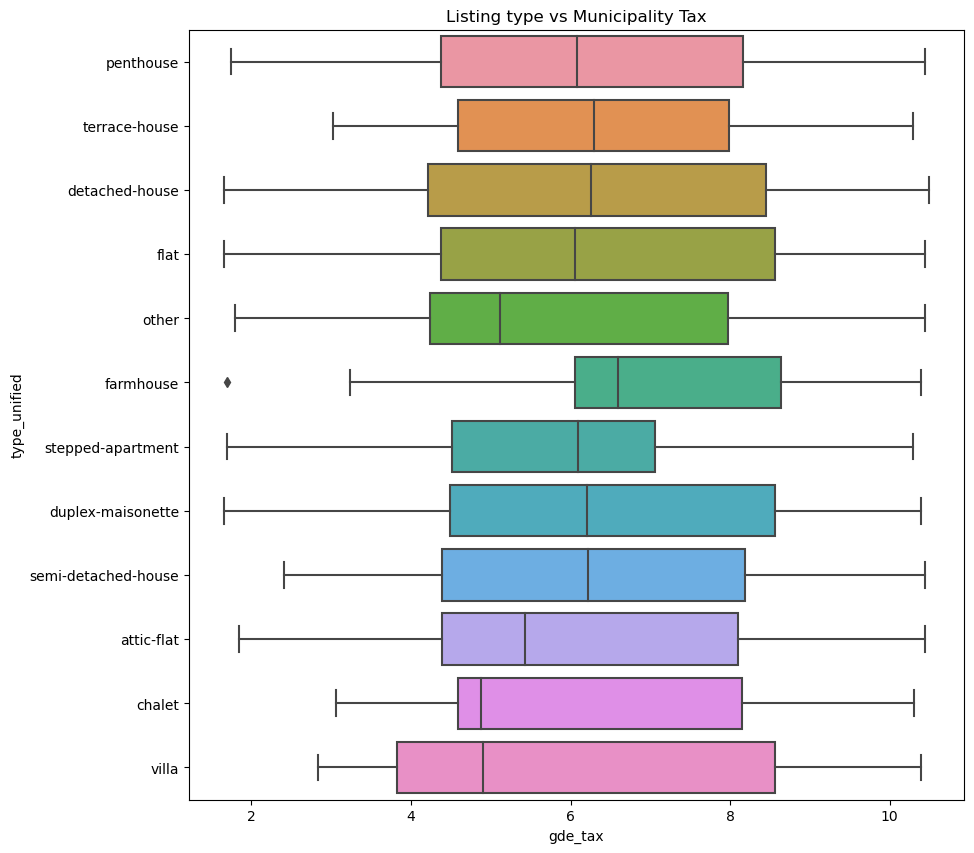

In [206]:
plt.figure(figsize=(10, 10))
sns.boxplot(data=df, x='gde_tax', y='type_unified')
plt.title('Listing type vs Municipality Tax')
plt.show()

Alle Immobilientypen weisen ähnliche Mittelwerte auf zweischen 5 und 7, ohne überraschende Abweichungen. Bauerhöfe weisen die höchsten Werte auf, was darauf hindeutet.

### Baujahr

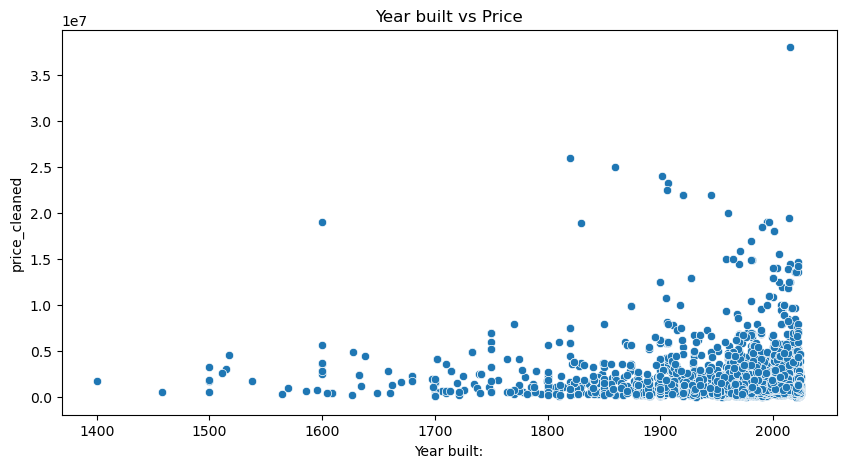

In [232]:
plt.figure(figsize=(10, 5))
sns.scatterplot(data=df, x='Year built:', y='price_cleaned')
plt.title('Year built vs Price')
plt.show()

Das Streudiagramm zeigt, dass es keine starke oder konsistente Beziehung zwischen dem Baujahr einer Immobilie und ihrem Preis gibt, mit einer breiten Verteilung der Preise über alle Altersgruppen. Allerdings scheint es in den letzten Jahren eine leichte Zunahme der Dichte höherpreisiger Immobilien zu geben, was darauf hindeutet, dass neuere Immobilien im Durchschnitt teurer sind.

### Umweltfaktoren

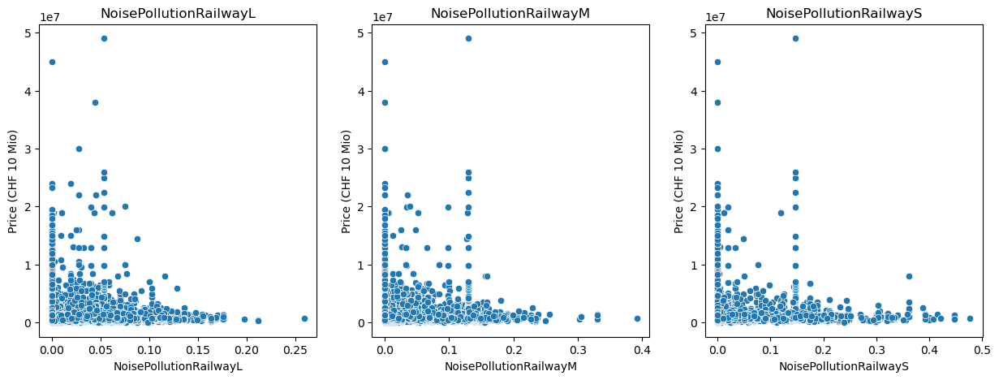

In [242]:
noise_pollution = ['NoisePollutionRailwayL', 'NoisePollutionRailwayM', 'NoisePollutionRailwayS']

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# loop through the list of noise pollution columns
for i, col in enumerate(noise_pollution):
    sns.scatterplot(data=df, x=col, y='price_cleaned', ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_ylabel('Price (CHF 10 Mio)')

Die Streudiagramme deuten darauf hin, dass es keine eindeutige, starke Korrelation zwischen der Lärmbelastung durch den Schienenverkehr und den Immobilienpreisen gibt. Es ist jedoch zu sehen, dass Immobilien mit tieferen Preisen mit der höchsten Lärmbelastungen verbunden zu sein scheinen.

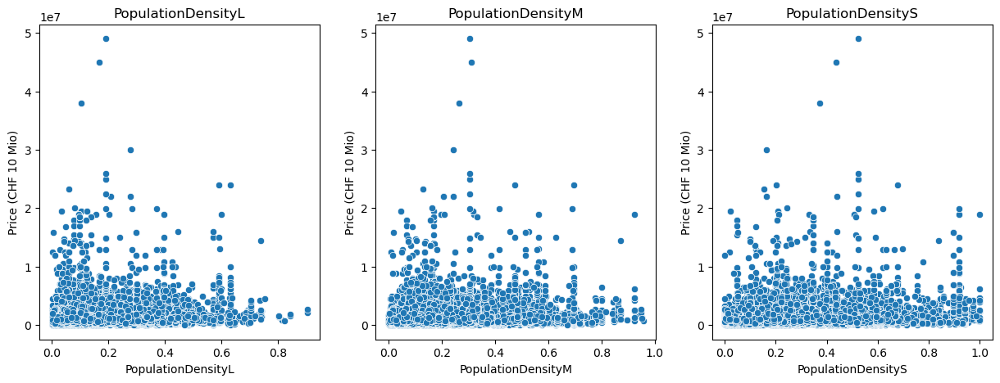

In [241]:
populations = ['PopulationDensityL', 'PopulationDensityM', 'PopulationDensityS']

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, col in enumerate(populations):
    sns.scatterplot(data=df, x=col, y='price_cleaned', ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_ylabel('Price (CHF 10 Mio)')

Diese Streudiagramme verdeutlichen, dass die Immobilienpreise über ein breites Spektrum von Bevölkerungsdichten verteilt sind, wobei kein klares Muster auf eine direkte Korrelation hindeutet. Die höchsten Immobilienpreise sind jedoch nicht unbedingt in den Gebieten mit der höchsten Bevölkerungsdichte zu finden, was darauf hindeutet, dass andere Faktoren als die Bevölkerungsdichte einen grösseren Einfluss auf die Immobilienpreise haben könnten.

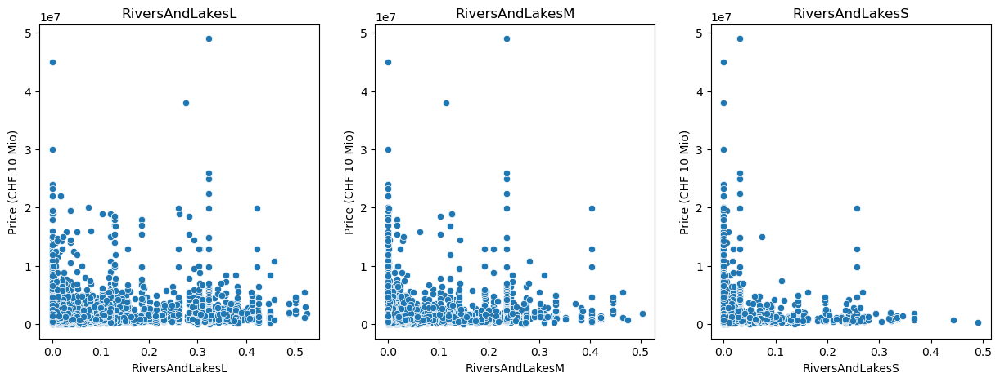

In [240]:
rivers_lakes = ['RiversAndLakesL', 'RiversAndLakesM', 'RiversAndLakesS']

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, col in enumerate(rivers_lakes):
    sns.scatterplot(data=df, x=col, y='price_cleaned', ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_ylabel('Price (CHF 10 Mio)')

Die Streudiagramme zeigen, dass sich die Nähe zu Flüssen und Seen nicht durchgängig auf die Immobilienpreise auswirkt, da die Preise über verschiedene Niveaus der Nähe gestreut sind, ohne dass ein klarer Trend erkennbar ist. Es ist jedoch zu beobachten, dass sich einige der teuersten Immobilien in Gebieten mit niedrigeren Werten für die Nähe befinden, was darauf hindeutet, dass bestimmte Immobilien in der Nähe von Gewässern höhere Preise erzielen, aber dies ist keine allgemeingültige Regel.

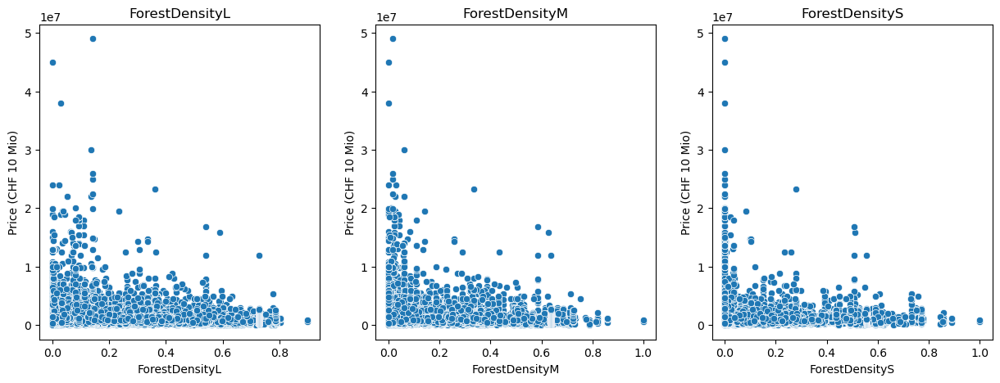

In [239]:
forest = ['ForestDensityL', 'ForestDensityM', 'ForestDensityS']

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, col in enumerate(forest):
    sns.scatterplot(data=df, x=col, y='price_cleaned', ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_ylabel('Price (CHF 10 Mio)')

Die Streudiagramme zeigen die Immobilienpreise im Verhältnis zur Walddichte und lassen eine breite Streuung der Preise über verschiedene Walddichten hinweg erkennen, ohne dass ein klares Muster erkennbar ist. Die teuersten Immobilien scheinen sich nicht auf Gebiete mit hoher oder niedriger Walddichte zu konzentrieren, was darauf hindeutet, dass die Walddichte allein nicht der Hauptfaktor für die Immobilienpreise ist.

Aus der Analyse der Streudiagramme lässt sich schliessen, dass Faktoren wie Lärmbelästigung durch Eisenbahnen, die Nähe zu Gewässern und die Walddichte keinen eindeutigen Trend in Bezug auf die Immobilienpreise aufzeigen. Die breite Streuung der Preise über die verschiedenen Ausprägungen dieser Faktoren hinweg deutet darauf hin, dass sie wahrscheinlich keinen bedeutenden Einfluss auf die Preisgestaltung haben und somit möglicherweise auch keine starke Vorhersagekraft für die Modellierung der Immobilienpreise besitzen.

### Ortschaften

Nun möchten wir die Ortschaften genauer betrachten. Dafür müssen wir die rohe Daten wieder laden.

In [171]:
df_raw = pd.read_csv('../data/immo_data_202208_v2.csv', low_memory=False)

In [172]:
df_locality_count = df_raw.groupby('Municipality')['Municipality'].count().sort_values(ascending=False)
df_locality_count = df_locality_count.reset_index(name='count')

cities = ["Zürich", "Aarau", "Lausanne", "Lugano", "Bern", "Basel", "Winterthur", "Luzern"]

df_locality_count[df_locality_count["Municipality"].isin(cities)]

,Municipality,count
1,Lugano,339
9,Lausanne,123
34,Basel,48
85,Luzern,32
90,Bern,31
99,Aarau,28
351,Winterthur,16


Interessant zu sehen, dass die meisten Städte, die wir herausgepickt haben, nicht viele Immobilien haben. Zürich hat gar keine. Dies liegt daran, dass die Daten so gescraped wurden.

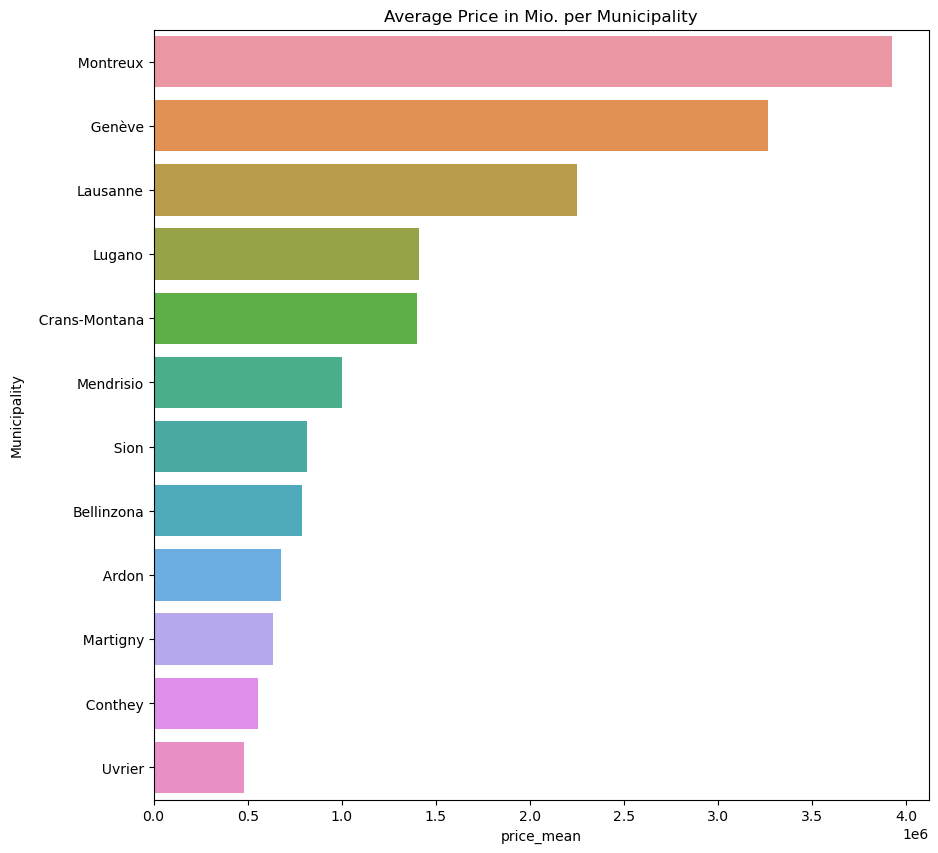

In [253]:
# aggregate df for price analysis by municipality
df_locality_mean = df_raw.groupby('Municipality').agg({'price_cleaned': 'mean', 'Municipality': 'count'})
df_locality_mean.columns = ['price_mean', 'count']
df_locality_mean = df_locality_mean.reset_index()

# sort the df by price_mean
df_locality_mean = df_locality_mean.sort_values(by='price_mean', ascending=False)

plt.figure(figsize=(10, 10))
sns.barplot(data=df_locality_mean[df_locality_mean['count'] > 100], x='price_mean', y='Municipality')
plt.title('Average Price in Mio. per Municipality')
plt.show()

Selbst in Gemeinden mit mehr als 100 Einträgen sind grosse Preisunterschiede feststellbar. Daher ist es unerlässlich, die Gemeinde als ein Merkmal in die maschinellen Lernmodelle aufzunehmen.

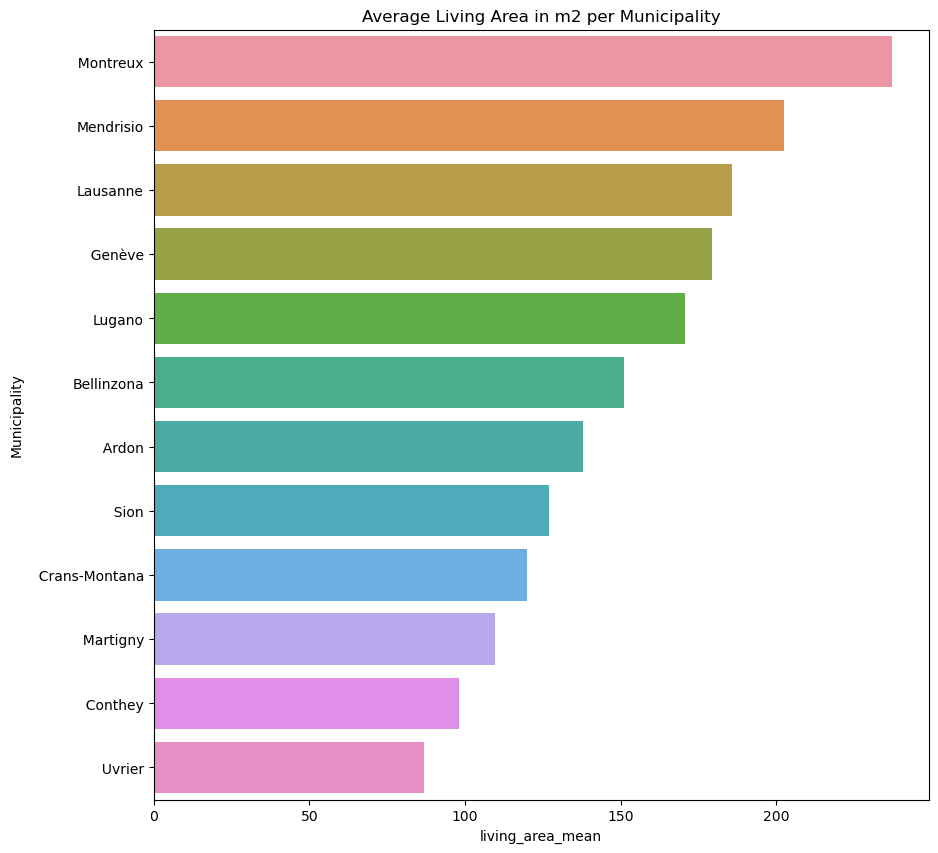

In [254]:
# aggregate df for living space analysis by municipality
df_locality_mean = df_raw.groupby('Municipality').agg({'Living_area_unified': 'mean', 'Municipality': 'count'})
df_locality_mean.columns = ['living_area_mean', 'count']
df_locality_mean = df_locality_mean.reset_index()

# sort the df by living_area_mean
df_locality_mean = df_locality_mean.sort_values(by='living_area_mean', ascending=False)

plt.figure(figsize=(10, 10))
sns.barplot(data=df_locality_mean[df_locality_mean['count'] > 100], x='living_area_mean', y='Municipality')
plt.title('Average Living Area in m2 per Municipality')
plt.show()

Wenn wir die Gemeinden anhand der durchschnittlichen Wohnfläche pro Immobilie betrachten, sehen wir, dass diese Gemeinden auch die teuersten sind (siehe "Average Price per Municipality" Plot oben).

### Geo Plots

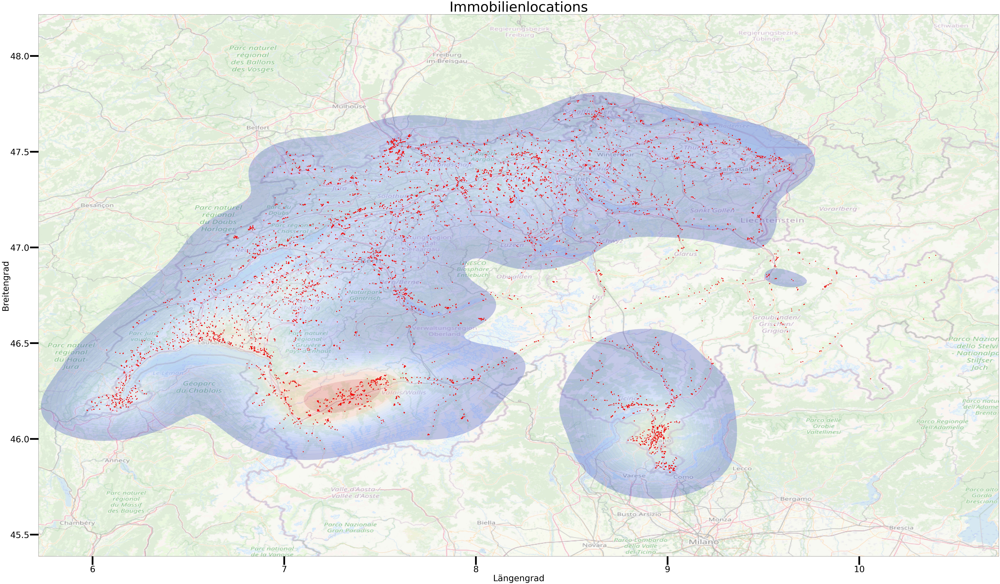

In [174]:
# plot lat and lon of df using geo pandas
gdf = geopandas.GeoDataFrame(df_raw, geometry=geopandas.points_from_xy(df_raw.lon, df_raw.lat))

#png and coordinates in "BBox" from "https://www.openstreetmap.org/"
BBox = (5.718,  10.728,      
         45.387, 48.217)

pic = plt.imread('../Bilder/schweiz.png')

fig, ax = plt.subplots(figsize = (100,100))
ax.set_title('Immobilienlocations', fontsize=80)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=50)
ax.set_ylabel('Breitengrad', fontsize=50)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
sns.kdeplot(data=gdf,
            x='lon', 
            y='lat', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax)
gdf.plot(markersize=20,ax=ax, color='red')
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)
plt.show()

Dieser Plot zeigt einen detaillierten und grossformatigen Plot, der die geografische Verteilung von Immobilien in der Schweiz aufzeigt. Durch die Verwendung eines KDE-Plots werden die Bereiche mit der höchsten Dichte an Immobilien hervorgehoben, während die einzelnen Standorte als rote Punkte markiert sind. Das Hintergrundbild der Schweiz hilft dabei, die Standorte in einen geografischen Kontext zu setzen.

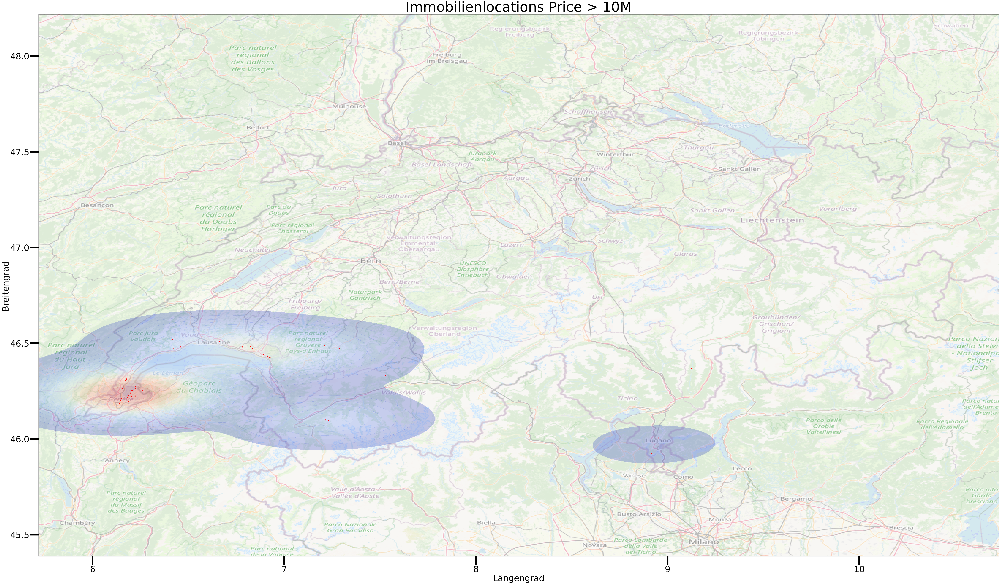

In [175]:
df_temp = df_raw[df_raw['price_cleaned'] > 10000000]
gdf = geopandas.GeoDataFrame(df_temp, geometry=geopandas.points_from_xy(df_temp.lon, df_temp.lat))

fig, ax = plt.subplots(figsize = (100,100))
ax.set_title('Immobilienlocations Price > 10M', fontsize=80)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=50)
ax.set_ylabel('Breitengrad', fontsize=50)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
sns.kdeplot(data=gdf,
            x='lon', 
            y='lat', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax)
gdf.plot(markersize=20,ax=ax, color='red')
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)
plt.show()

Hier sehen wir die geografische Verteilung von Immobilien im höherpreisigen Segment (über 10 Millionen). Es ist interessant zu sehen, dass die meisten Immobilien in der Nähe von Genf liegen. Im Wallis und Tessin sind auch einige zu finden.

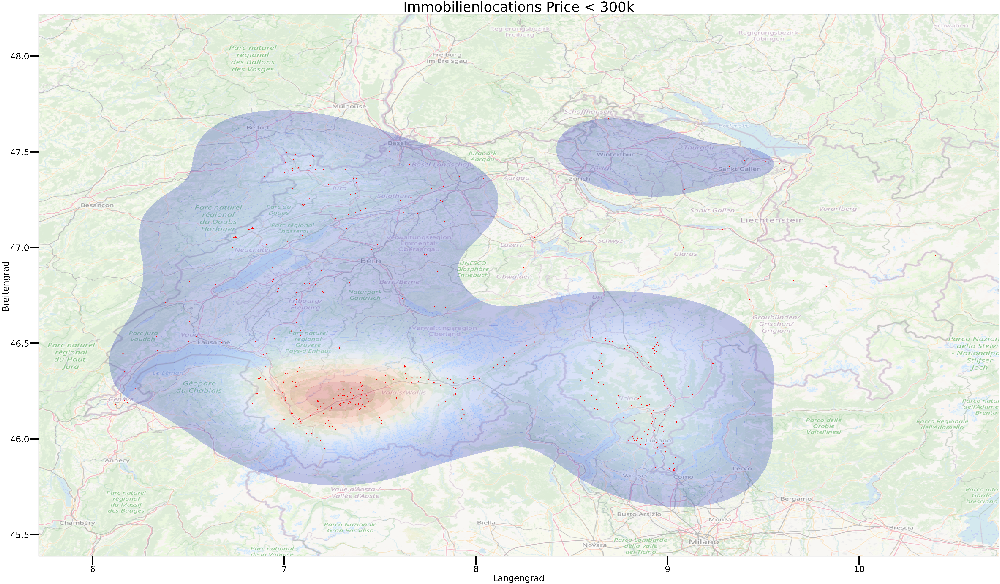

In [176]:
df_temp = df_raw[df_raw['price_cleaned'] < 300000]

gdf = geopandas.GeoDataFrame(df_temp, geometry=geopandas.points_from_xy(df_temp.lon, df_temp.lat))

fig, ax = plt.subplots(figsize = (100,100))
ax.set_title('Immobilienlocations Price < 300k', fontsize=80)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=50)
ax.set_ylabel('Breitengrad', fontsize=50)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
sns.kdeplot(data=gdf,
            x='lon', 
            y='lat', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax)
gdf.plot(markersize=20,ax=ax, color='red')
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)
plt.show()

Hier sehen wir die Verteilung von Immobilien im günstigeren Preissegment (unter 300'000). Es ist besonders interessant zu analysieren, in welchen Regionen diese preiswerteren Immobilien konzentriert sind und wie sich ihre Verteilung im Vergleich zu den teureren Immobilien darstellt. Die preisgünstigsten Immobilien sind hauptsächlich im Wallis und Tessin zu finden. 

Wir müssen aber immer im Kopf behalten, dass die Datenverteilung nicht der Realität repräsentiert, da die Daten so gescraped wurden.

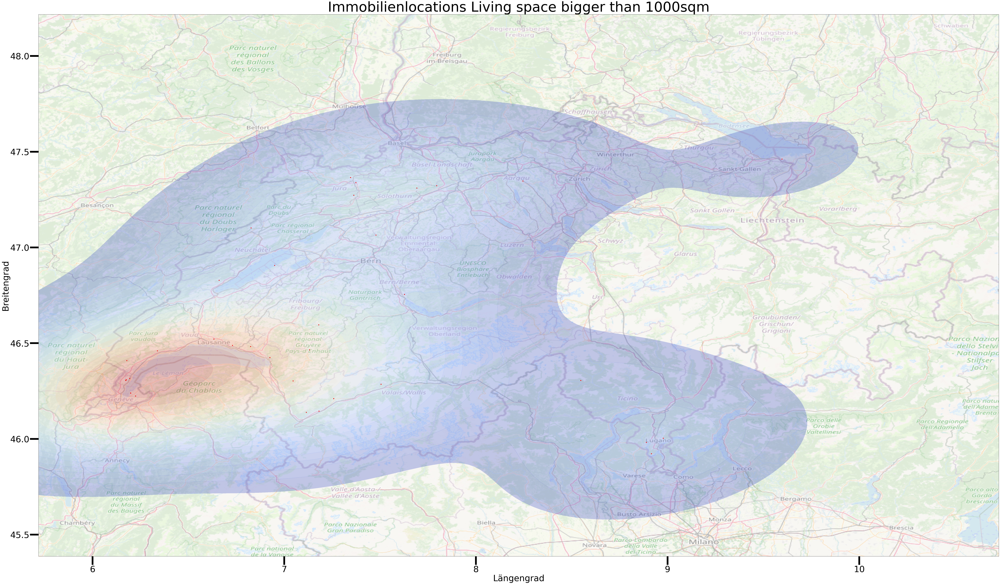

In [177]:
df_temp = df_raw[df_raw['Living_area_unified'] > 1000]
gdf = geopandas.GeoDataFrame(df_temp, geometry=geopandas.points_from_xy(df_temp.lon, df_temp.lat))

fig, ax = plt.subplots(figsize = (100,100))
ax.set_title('Immobilienlocations Living space bigger than 1000sqm', fontsize=80)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=50)
ax.set_ylabel('Breitengrad', fontsize=50)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
sns.kdeplot(data=gdf,
            x='lon', 
            y='lat', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax)
gdf.plot(markersize=20,ax=ax, color='red')
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)
plt.show()

Dieser Plot zeigt die Verteilung mit grossen Wohnflächen (> 1000m²). Die Immobilien im orangen Bereich waren auch im Bereich der teuersten. Es macht also Sinn, dass die Immobilien mit grossen Wohnflächen auch im teureren Segment liegen.

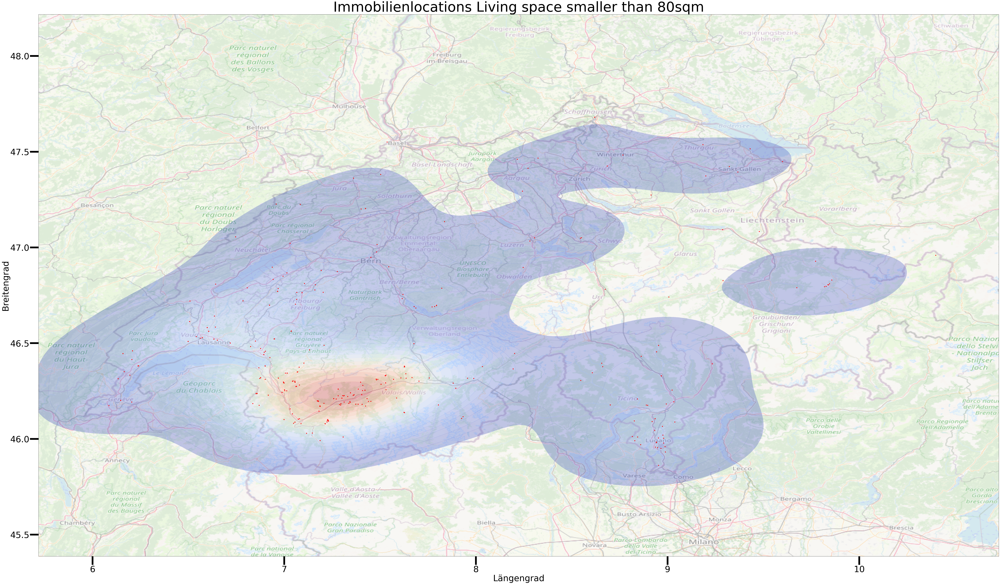

In [178]:
df_temp = df_raw[df_raw['Living_area_unified'] < 50]
gdf = geopandas.GeoDataFrame(df_temp, geometry=geopandas.points_from_xy(df_temp.lon, df_temp.lat))

fig, ax = plt.subplots(figsize = (100,100))
ax.set_title('Immobilienlocations Living space smaller than 80sqm', fontsize=80)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=50)
ax.set_ylabel('Breitengrad', fontsize=50)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
sns.kdeplot(data=gdf,
            x='lon', 
            y='lat', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax)
gdf.plot(markersize=20,ax=ax, color='red')
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)
plt.show()

Visualiserung von kleineren Immobilien mit weniger als 50 Quadratmetern. Das sind sehr wahrscheinlich Rusticos oder kleine Ferienwohnungen.

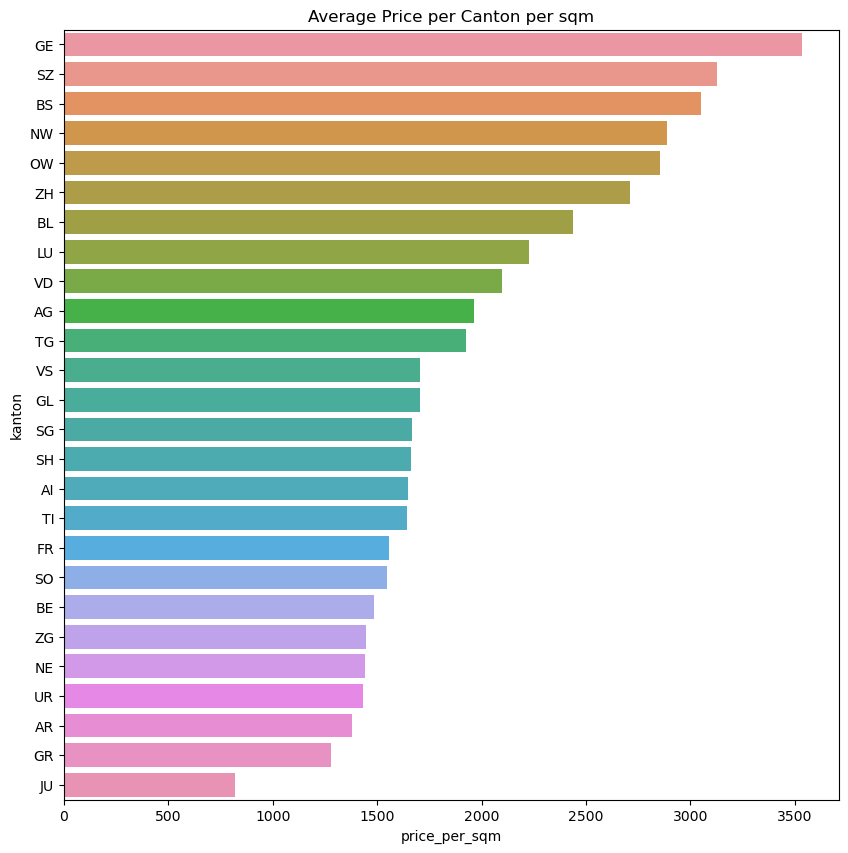

In [207]:
# Calculating the price per sqm per canton
df['price_per_sqm'] = df['price_cleaned'] / (df['Living_area_unified'] + df['Plot_area_unified'])
joined_df_merged = df.groupby('kanton').agg({'price_per_sqm': 'mean'})
joined_df_merged = joined_df_merged.reset_index()
joined_df_merged = joined_df_merged.sort_values(by='price_per_sqm', ascending=False)
plt.figure(figsize=(10, 10))
sns.barplot(data=joined_df_merged, x='price_per_sqm', y='kanton')
plt.title('Average Price per sqm per canton ')
plt.show()

Genf hat die höchste Preise pro Quadratmeter. Dies ist nicht überraschend, da Genf eine der teuersten Städte der Schweiz ist. Danach folgen Schwiz und Basel-Stadt. Die günstigsten Kantone sind Jura, Graubünden und Appenzell Ausserrhoden.

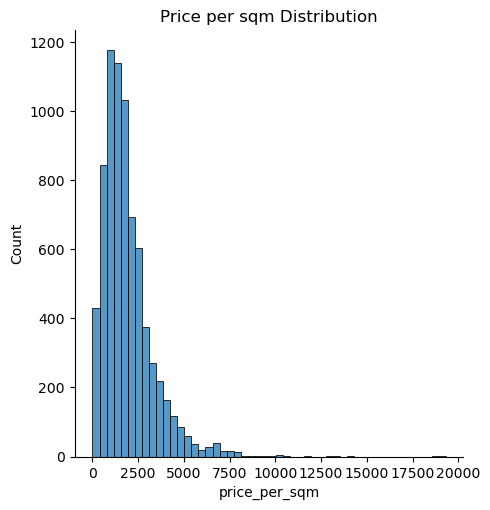

In [217]:
sns.displot(df['price_per_sqm'], bins=50)
plt.title('Price per sqm Distribution')
plt.show()

Der Preis pro Quadratmeter liegt meistens zwischen CHF 1'500 und 3'500.

Hier schauen wir Preise anhand der politischen Variablen gruppiert nach Postleitzahlen an.

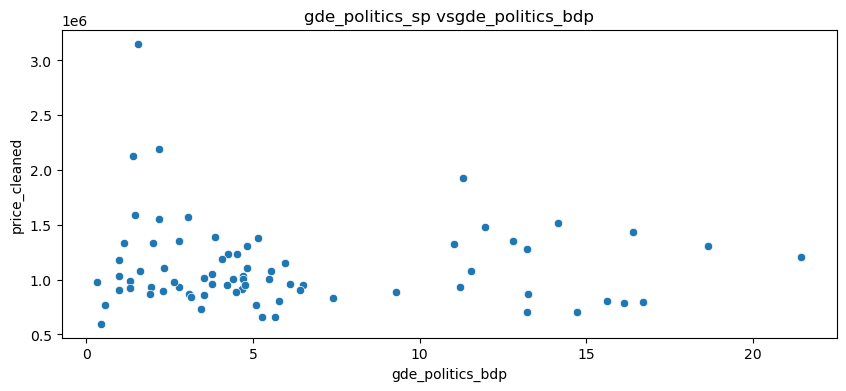

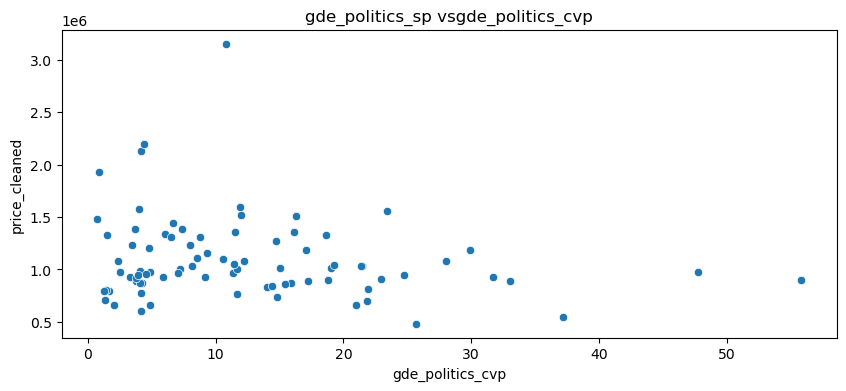

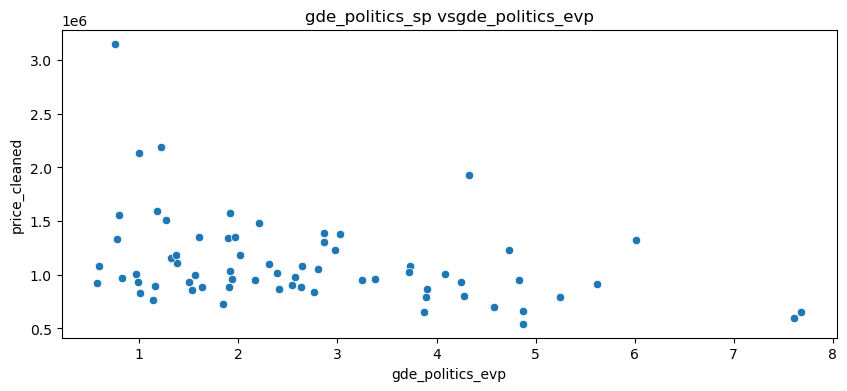

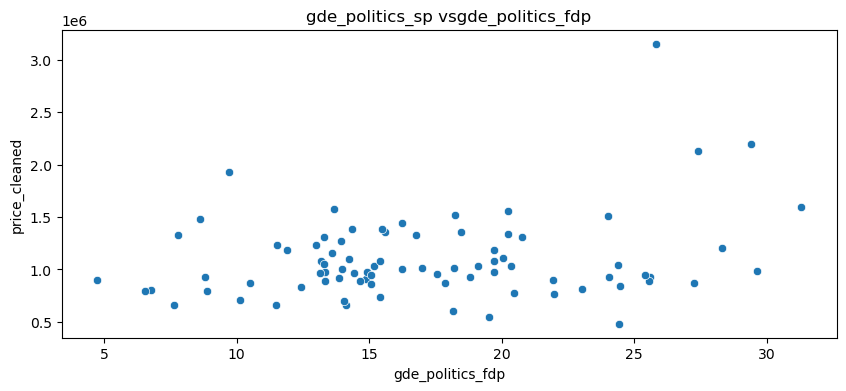

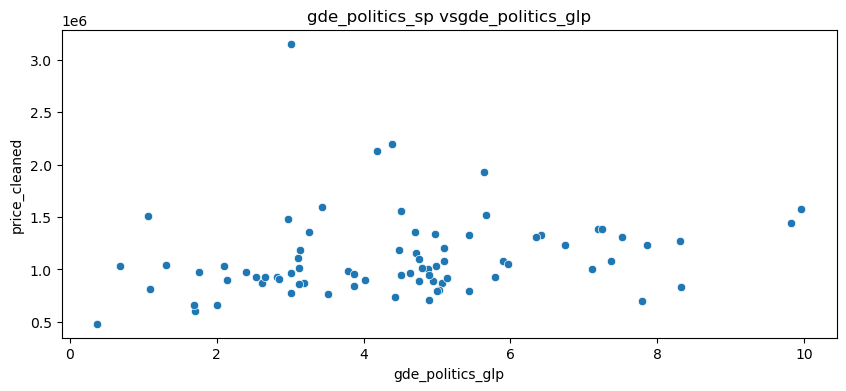

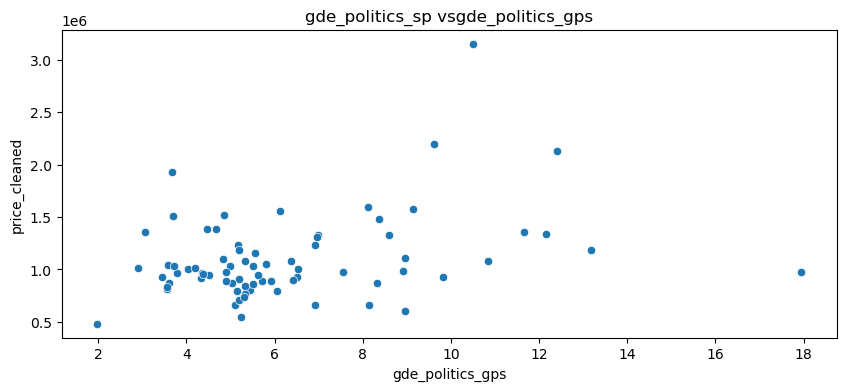

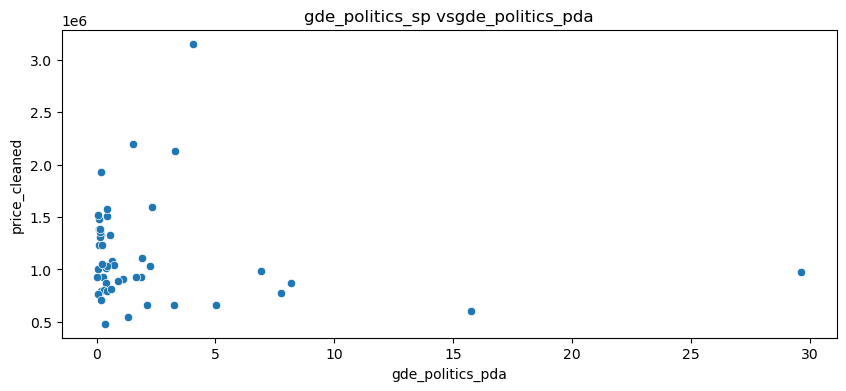

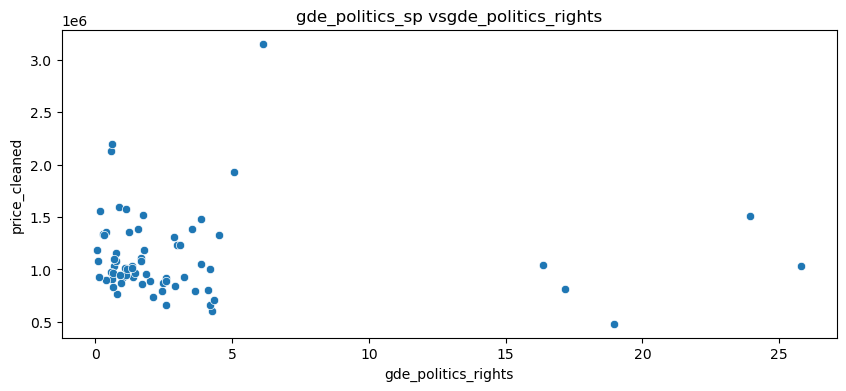

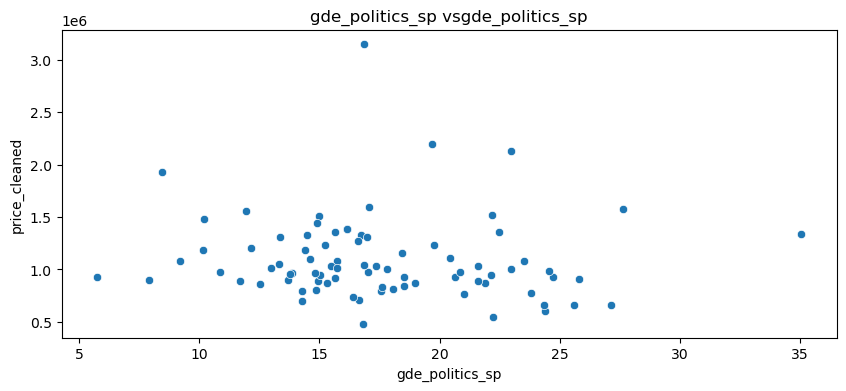

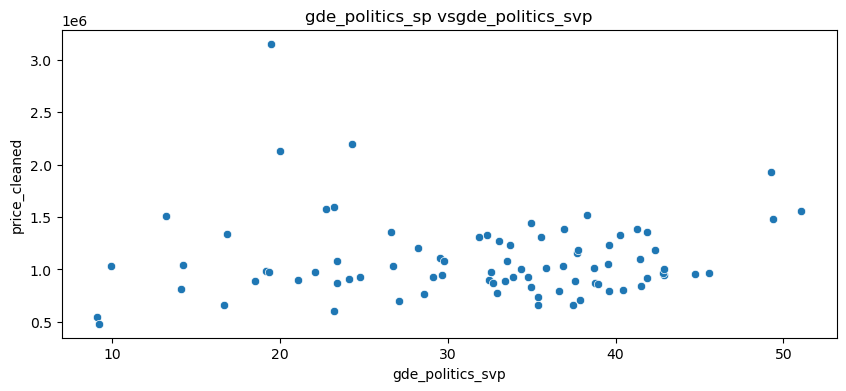

In [218]:
df_gde_politics = df[['gde_politics_bdp', 'gde_politics_cvp', 'gde_politics_evp',
       'gde_politics_fdp', 'gde_politics_glp', 'gde_politics_gps',
       'gde_politics_pda', 'gde_politics_rights', 'gde_politics_sp',
       'gde_politics_svp','Zip','price_cleaned']]

# calculate the mean of each column per zip code
df_gde_politics = df_gde_politics.groupby('Zip').mean()

# reset the index
df_gde_politics = df_gde_politics.reset_index()

for col in ['gde_politics_bdp', 'gde_politics_cvp', 'gde_politics_evp','gde_politics_fdp', 'gde_politics_glp', 'gde_politics_gps','gde_politics_pda', 'gde_politics_rights', 'gde_politics_sp','gde_politics_svp']:    
       plt.figure(figsize=(10, 4))
       sns.scatterplot(data=df_gde_politics, x=col, y='price_cleaned')
       plt.title('gde_politics_sp vs' + col)
       plt.show()

Die Preise sehen recht zufällig aus, also es ist schwierig, einen Trend oder Muster zu finden. Das könnte heissen, dass diese Variablen nicht wichtig sein werden.

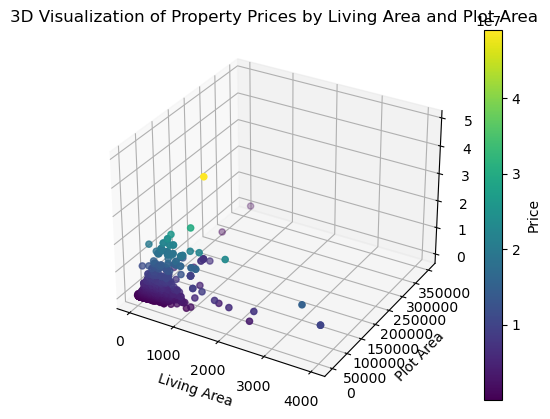

In [255]:
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatterplot using Seaborn
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define the x, y, and z values from your DataFrame
x = df['Living_area_unified']
y = df['Plot_area_unified']
z = df['price_cleaned']

# Create the 3D scatterplot with Seaborn
scatter = ax.scatter(x, y, z, c=z, cmap='viridis', marker='o')
ax.set_title('3D Visualization of Property Prices by Living Area and Plot Area')
ax.set_xlabel('Living Area')
ax.set_ylabel('Plot Area')
ax.set_zlabel('Price')

# Add a color bar
cbar = fig.colorbar(scatter)
cbar.set_label('Price')

plt.show()

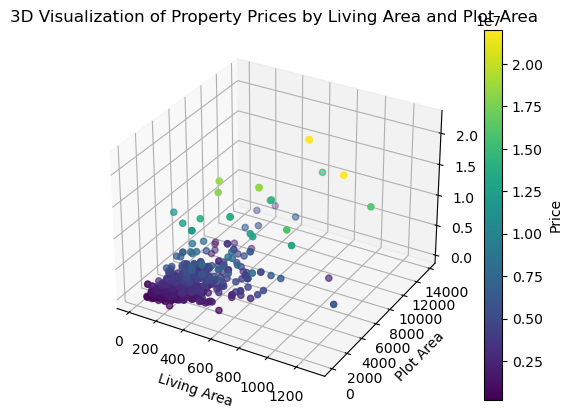

In [256]:
# same as above but only for type_unified = 'detached house'
df_temp = df[df['type_unified'] == 'villa']
# Create a 3D scatterplot using Seaborn
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define the x, y, and z values from your DataFrame
x = df_temp['Living_area_unified']
y = df_temp['Plot_area_unified']
z = df_temp['price_cleaned']

# Create the 3D scatterplot with Seaborn
scatter = ax.scatter(x, y, z, c=z, cmap='viridis', marker='o')
ax.set_title('3D Visualization of Property Prices by Living Area and Plot Area')
ax.set_xlabel('Living Area')
ax.set_ylabel('Plot Area')
ax.set_zlabel('Price')

# Add a color bar
cbar = fig.colorbar(scatter)
cbar.set_label('Price')

plt.show()

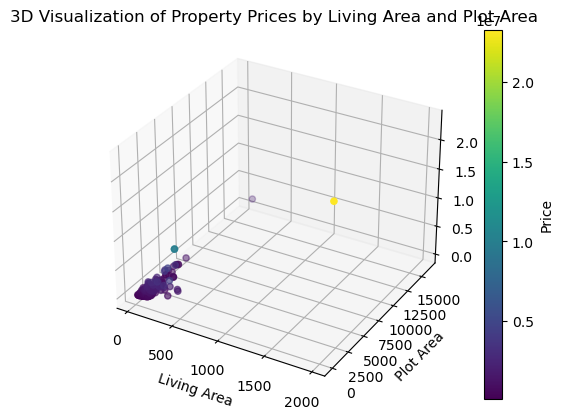

In [257]:
# same as above but only for type_unified = 'detached house'
df_temp = df[df['type_unified'] == 'flat']

# Create a 3D scatterplot using Seaborn
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define the x, y, and z values from your DataFrame
x = df_temp['Living_area_unified']
y = df_temp['Plot_area_unified']
z = df_temp['price_cleaned']

# Create the 3D scatterplot with Seaborn
scatter = ax.scatter(x, y, z, c=z, cmap='viridis', marker='o')
ax.set_title('3D Visualization of Property Prices by Living Area and Plot Area')
ax.set_xlabel('Living Area')
ax.set_ylabel('Plot Area')
ax.set_zlabel('Price')

# Add a color bar
cbar = fig.colorbar(scatter)
cbar.set_label('Price')

plt.show()